In [43]:
import os 
import tell
import shutil
import itertools
from datetime import datetime, timedelta
import numpy as np



In [44]:
#Predefine variable
dir_for_files='/Users/ansonkong/Downloads/project_data/'#Replace it with any place you like, it just a place to store file
target_year=2042#Please  pick year 2021 to 2100
scenario=r'rcp45hotter_ssp3'
seed=1234

IMPORTANT, the following chunk of code must be run prior to anythinh else, also, download the weather data manuaally after this

In [60]:

current_dir =  dir_for_files
tell_data_dir = os.path.join(current_dir, r'tell_data')
ba_abbrev_list = tell.get_balancing_authority_to_model_dict().keys()
future_weather_folder = os.path.join(tell_data_dir, r'sample_forcing_data', r'future_weather', scenario)
def generate_folder_names(base_name):
    # Define possible replacement options
    rcp_options = ['rcp85', 'rcp45'] if 'rcp85' in base_name else ['rcp45']
    temperature_options = ['hotter', 'cooler'] if 'hotter' in base_name else ['cooler']
    ssp_options = ['ssp5', 'ssp3'] if 'ssp5' in base_name else ['ssp3']

    # Generate all combinations of the options
    combinations = list(itertools.product(rcp_options, temperature_options, ssp_options))
    
    # Construct new folder names based on combinations
    # Assuming the format is always RCP_TEMPERATURE_SSP
    folder_names = []
    for comb in combinations:
        new_name = base_name
        for rcp in rcp_options:
            if rcp in new_name:
                new_name = new_name.replace(rcp, comb[0])
                break
        for temp in temperature_options:
            if temp in new_name:
                new_name = new_name.replace(temp, comb[1])
                break
        for ssp in ssp_options:
            if ssp in new_name:
                new_name = new_name.replace(ssp, comb[2])
                break
        folder_names.append(new_name)

    return folder_names

# Function to copy the base folder into new folders with the generated names
def copy_folders(base_folder_path, new_folder_paths):
    for new_folder in new_folder_paths:
        new_path = os.path.join(os.path.dirname(base_folder_path), new_folder)
        if not os.path.exists(new_path):
            shutil.copytree(base_folder_path, new_path)
        else:
            print(f"Folder {new_path} already exists.")



def tell_start(dir_for_files):
    """Load pre-exist data

    :param dir_for_file:                    The directory to store all the file, the current training data run from 2015 to 2019
    :type dir_for_file:                     string


    """
    # Identify the current working directory, the subdirectory where the data will be stored, and the image output subdirectory:
    current_dir =  dir_for_files
    tell_data_dir = os.path.join(current_dir, r'tell_data')
    tell_image_dir = os.path.join(tell_data_dir, r'visualizations')

    # If the "tell_data_dir" subdirectory doesn't exist then create it:
    if not os.path.exists(tell_data_dir):
        os.makedirs(tell_data_dir)
    # Download the TELL raw data package from Zenodo:
    tell.install_tell_raw_data(data_dir = tell_data_dir)
    # Download the TELL quickstarter data package from Zenodo:
    tell.install_quickstarter_data(data_dir = tell_data_dir)
    tell.install_forcing_data.install_sample_forcing_data(data_dir=tell_data_dir)
    print('Location of Tell data'+tell_data_dir)
    # Base folder name and path
    #Please don't change here, this is an file name that has already download
    base_folder_name = 'rcp85hotter_ssp5'
    base_folder_path = os.path.join(tell_data_dir,r'sample_forcing_data',r'sample_gcam_usa_data', r'rcp85hotter_ssp5')

    # Generate new folder names
    new_folder_names = generate_folder_names(base_folder_name)

    # Generate full new folder paths (optional, depending on your use case)
    new_folder_paths = [os.path.join(os.path.dirname(base_folder_path), name) for name in new_folder_names]
    print(new_folder_paths)
    # Copy the base folder into new folders
    copy_folders(base_folder_path, new_folder_paths)

def mlp(target_year,scenario,current_dir):
    current_dir =  dir_for_files
    tell_data_dir = os.path.join(current_dir, r'tell_data')
    ba_abbrev_list = tell.get_balancing_authority_to_model_dict().keys()
    # Run the MLP prediction step for the list of BAs using parallel processing streams:
    
    pdf = tell.predict_batch(target_region_list = ba_abbrev_list,
                            year = target_year,
                            data_dir = os.path.join(tell_data_dir, r'sample_forcing_data', r'future_weather', scenario),
                            datetime_field_name = 'Time_UTC',
                            save_prediction = True,
                            prediction_output_directory = os.path.join(tell_data_dir, r'tell_quickstarter_data', r'outputs', r'mlp_output', scenario),
                            n_jobs = -1)
#mlp(target_year,scenario,current_dir)
"""
    Data considering to be change by us
    We can ignore gcam if we ignore the scale part(whihch should be)
    gcam_usa_input_dir = os.path.join(data_input_dir, r'sample_forcing_data', r'sample_gcam_usa_data', scenario_to_process)

    Mapping data seems okay to maintain
    map_input_dir = os.path.join(data_input_dir, r'tell_quickstarter_data', r'outputs', r'ba_service_territory')


    mlp_input_dir = os.path.join(data_input_dir, r'tell_quickstarter_data', r'outputs', r'mlp_output', scenario_to_process, year_to_process)
    
    Modify year(Done)
    pop_input_dir = os.path.join(data_input_dir, r'sample_forcing_data', r'sample_population_projections')
"""
import pandas as pd
import os

def modify_year(dir_for_files: str, target_year: int, growth_rate: float):
    pop_input = os.path.join(dir_for_files, 'tell_data', 'sample_forcing_data', 'sample_population_projections', 'ssp5_county_population.csv')
    pop_df = pd.read_csv(pop_input)
    print(pop_df.columns)
    pop_df = pop_df[['FIPS', '2020', 'state_name']]
    pop_df[target_year] = pop_df['2020'] * (1 + growth_rate) ** (target_year - 2020)
    # Specify index=False to avoid writing the DataFrame index to the CSV file
    pop_df.to_csv(pop_input, index=False)


#modify_year(dir_for_files,target_year,0.02)


def generate_data_for_year_and_authorities(folder_path, year, ba_abbrev_list):
    # Define the start and end of the year
    start_date = datetime(year, 1, 1, 0, 0)
    end_date = datetime(year, 12, 31, 23, 0)
    
    # Calculate the number of hours in the year
    num_hours = int((end_date - start_date).total_seconds() / 3600) + 1
    
    # Generate dates
    dates = [start_date + timedelta(hours=i) for i in range(num_hours)]
    
    # Define distribution parameters based on the provided file summary
    T2_mean, T2_std = 288.66, 12.06
    Q2_mean, Q2_std = 0.005455, 0.00225
    SWDOWN_mean, SWDOWN_std = 225.34, 304.81
    GLW_mean, GLW_std = 307.28, 50.38
    WSPD_mean, WSPD_std = 2.97, 1.38
    
    # Ensure the folder exists
    if not os.path.exists(folder_path):
        os.makedirs(folder_path)
    
    for ba in ba_abbrev_list:
        # Generate data
        T2 = np.random.normal(T2_mean, T2_std, num_hours)
        Q2 = np.random.normal(Q2_mean, Q2_std, num_hours)
        SWDOWN = np.abs(np.random.normal(SWDOWN_mean, SWDOWN_std, num_hours))  # Ensure positive values
        GLW = np.random.normal(GLW_mean, GLW_std, num_hours)
        WSPD = np.random.normal(WSPD_mean, WSPD_std, num_hours)
        
        # Create a dataframe
        df = pd.DataFrame({
            'Time_UTC': dates,
            'T2': T2,
            'Q2': Q2,
            'SWDOWN': SWDOWN,
            'GLW': GLW,
            'WSPD': WSPD
        })
        
        # Format Time_UTC as string
        df['Time_UTC'] = df['Time_UTC'].dt.strftime('%Y-%m-%d %H:%M:%S')
        
        # Save to CSV
        file_name = f"{ba}_WRF_Hourly_Mean_Meteorology_{year}.csv"
        file_path = os.path.join(folder_path, file_name)
        df.to_csv(file_path, index=False)
        
    return "Data generation completed."


def Prediction(dir_for_files,target_year,scenario):
    from tell.execute_forward import execute_forward
    current_dir =  dir_for_files
    tell_data_dir = os.path.join(current_dir, r'tell_data')
    result=execute_forward(str(target_year), scenario, tell_data_dir, save_county_data=False)
    #Note the county level data seems broken
    #Remove bad scaling factor, keep only raw Tell output
    result[0]=result[0][['Year','State_Name','State_FIPS','Raw_TELL_Load_TWh']]
    result[1]=result[1][['BA_Code','BA_Number','Time_UTC','Raw_TELL_BA_Load_MWh']]
    result[2]=result[2][['State_Name','State_FIPS','Time_UTC','Raw_TELL_BA_Load_MWh']]
    return result

tell_start(dir_for_files)



SyntaxError: keyword argument repeated: save_prediction (336100533.py, line 87)

#

In [83]:
import os
import pandas as pd
def weather_prediction_gen(dir_for_files, start_year, duration, scenario):
    current_dir = dir_for_files
    tell_data_dir = os.path.join(current_dir, 'tell_data')
    # Train the empirical models using the standard settings:
    prediction_df, validation_df = tell.train_batch(target_region_list = (tell.get_balancing_authority_to_model_dict().keys()),
                                                data_dir = os.path.join(tell_data_dir, r'tell_quickstarter_data', r'outputs', r'compiled_historical_data'),
                                                n_jobs = -1)
    prediction_df['BA_Code']=prediction_df['region']
    prediction_df['Difference'] = prediction_df['predictions'] - prediction_df['ground_truth']
    # Extract year, month, and day for further grouping
    prediction_df['datetime'] = pd.to_datetime(prediction_df['datetime'])
    prediction_df['Year'] = prediction_df['datetime'].dt.year
    prediction_df['Month'] = prediction_df['datetime'].dt.month
    prediction_df['Day'] = prediction_df['datetime'].dt.day
    
    # Yearly standard deviation
    yearly = prediction_df.groupby('BA_Code')['Difference'].std().reset_index(name='Yearly_SD')
    
    # Monthly standard deviation
    monthly = prediction_df.groupby(['BA_Code', 'Month'])['Difference'].std().reset_index(name='Monthly_SD')
    
    # Daily standard deviation
    daily = prediction_df.groupby(['BA_Code', 'Month', 'Day'])['Difference'].std().reset_index(name='Daily_SD')
    
    # Initialize empty DataFrames to store concatenated results
    all_summary_df = pd.DataFrame()
    all_BA_df = pd.DataFrame()
    all_State_df = pd.DataFrame()
    
    for target_year in range(start_year, start_year + duration):
        mlp(target_year, scenario, current_dir)  # Assuming this function is defined elsewhere and prepares the data
        
        # Assuming Prediction function returns DataFrames for the current year
        summary_df, BA_df, State_df = Prediction(dir_for_files, target_year, scenario)
        
        # Concatenate the DataFrames vertically
        all_summary_df = pd.concat([all_summary_df, summary_df], ignore_index=True)
        all_BA_df = pd.concat([all_BA_df, BA_df], ignore_index=True)
        all_State_df = pd.concat([all_State_df, State_df], ignore_index=True)
    # Prepare all_BA_df's Time_UTC for matching
    all_BA_df['Time_UTC'] = pd.to_datetime(all_BA_df['Time_UTC'])
    all_BA_df['Year'] = all_BA_df['Time_UTC'].dt.year
    all_BA_df['Month'] = all_BA_df['Time_UTC'].dt.month
    all_BA_df['Day'] = all_BA_df['Time_UTC'].dt.day
    # Merge yearly standard deviation
    all_BA_df = pd.merge(all_BA_df, yearly, how='left', on=['BA_Code'])
    all_BA_df.rename(columns={'Yearly_SD': 'Historical_Yearly_Standard_Deviation'}, inplace=True)

    # Merge monthly standard deviation
    # For monthly, ensure we're matching on both BA_Code and the month
    monthly['Month'] = monthly['Month'].astype(int)  # Ensure the month is integer for matching
    all_BA_df = pd.merge(all_BA_df, monthly, how='left', on=['BA_Code', 'Month'])
    all_BA_df.rename(columns={'Monthly_SD': 'Historical_Monthly_Standard_Deviation'}, inplace=True)

    # Merge daily standard deviation
    # For daily, ensure we're matching on BA_Code, month, and day
    daily['Month'] = daily['Month'].astype(int)  # Ensure the month is integer for matching
    daily['Day'] = daily['Day'].astype(int)  # Ensure the day is integer for matching
    all_BA_df = pd.merge(all_BA_df, daily, how='left', on=['BA_Code', 'Month', 'Day'])
    all_BA_df.rename(columns={'Daily_SD': 'Historical_Daily_Standard_Deviation'}, inplace=True)
            
    # At this point, all_summary_df, all_BA_df, and all_State_df contain the concatenated DataFrames for all years
    # You can now return these DataFrames or proceed with further processing
    return all_summary_df, all_BA_df, all_State_df


start_year = 2021
duration = 5  # For example, generate predictions for 5 years
scenario = 'rcp85hotter_ssp5'  # Example scenario
all_summary_df, all_BA_df, all_State_df = weather_prediction_gen(dir_for_files, start_year, duration, scenario)


        

Start time =  2024-02-15 17:14:46.236291


/opt/anaconda3/lib/python3.9/site-packages/tell/execute_forward.py:120: FutureWarning: 'Y' is deprecated and will be removed in a future version, please use 'YE' instead.
  population_interp_df = population_dft.resample('1Y').mean().interpolate('linear').T


End time =  2024-02-15 17:16:43.359367
Elapsed time =  0:01:57.123516
Start time =  2024-02-15 17:16:47.043556


/opt/anaconda3/lib/python3.9/site-packages/tell/execute_forward.py:120: FutureWarning: 'Y' is deprecated and will be removed in a future version, please use 'YE' instead.
  population_interp_df = population_dft.resample('1Y').mean().interpolate('linear').T


End time =  2024-02-15 17:18:38.280409
Elapsed time =  0:01:51.237291
Start time =  2024-02-15 17:18:41.946061


/opt/anaconda3/lib/python3.9/site-packages/tell/execute_forward.py:120: FutureWarning: 'Y' is deprecated and will be removed in a future version, please use 'YE' instead.
  population_interp_df = population_dft.resample('1Y').mean().interpolate('linear').T


End time =  2024-02-15 17:20:33.352325
Elapsed time =  0:01:51.406716
Start time =  2024-02-15 17:20:36.923343


/opt/anaconda3/lib/python3.9/site-packages/tell/execute_forward.py:120: FutureWarning: 'Y' is deprecated and will be removed in a future version, please use 'YE' instead.
  population_interp_df = population_dft.resample('1Y').mean().interpolate('linear').T


End time =  2024-02-15 17:22:29.576095
Elapsed time =  0:01:52.653188
Start time =  2024-02-15 17:22:33.246156


/opt/anaconda3/lib/python3.9/site-packages/tell/execute_forward.py:120: FutureWarning: 'Y' is deprecated and will be removed in a future version, please use 'YE' instead.
  population_interp_df = population_dft.resample('1Y').mean().interpolate('linear').T


End time =  2024-02-15 17:24:24.401647
Elapsed time =  0:01:51.155965


In [80]:
all_BA_df


,BA_Code,BA_Number,Time_UTC,Raw_TELL_BA_Load_MWh,Scaled_TELL_BA_Load_MWh
0,AEC,189.0,2021-01-01 00:00:00,523.37,530.83
1,AEC,189.0,2021-01-01 01:00:00,553.52,561.41
2,AEC,189.0,2021-01-01 02:00:00,565.23,573.29
3,AEC,189.0,2021-01-01 03:00:00,540.34,548.04
4,AEC,189.0,2021-01-01 04:00:00,516.85,524.22
...,...,...,...,...,...
2366491,WAUW,19610.0,2025-12-31 19:00:00,95.86,87.74
2366492,WAUW,19610.0,2025-12-31 20:00:00,95.69,87.59
2366493,WAUW,19610.0,2025-12-31 21:00:00,95.79,87.68
2366494,WAUW,19610.0,2025-12-31 22:00:00,96.55,88.37


In [69]:
prediction_df
# View the validation dataframe that contains error statistics for the trained models:
prediction_df.to_csv('/Users/ansonkong/Downloads/valiation.csv')

In [70]:
prediction_df


,datetime,predictions,ground_truth,region
0,2019-01-01 00:00:00,441.698984,462.0,AEC
1,2019-01-01 01:00:00,457.118519,463.0,AEC
2,2019-01-01 02:00:00,474.831154,460.0,AEC
3,2019-01-01 03:00:00,445.018476,438.0,AEC
4,2019-01-01 04:00:00,411.232439,415.0,AEC
...,...,...,...,...
8755,2019-12-31 19:00:00,97.978161,105.0,WAUW
8756,2019-12-31 20:00:00,97.468806,104.0,WAUW
8757,2019-12-31 21:00:00,97.019297,104.0,WAUW
8758,2019-12-31 22:00:00,96.915057,99.0,WAUW


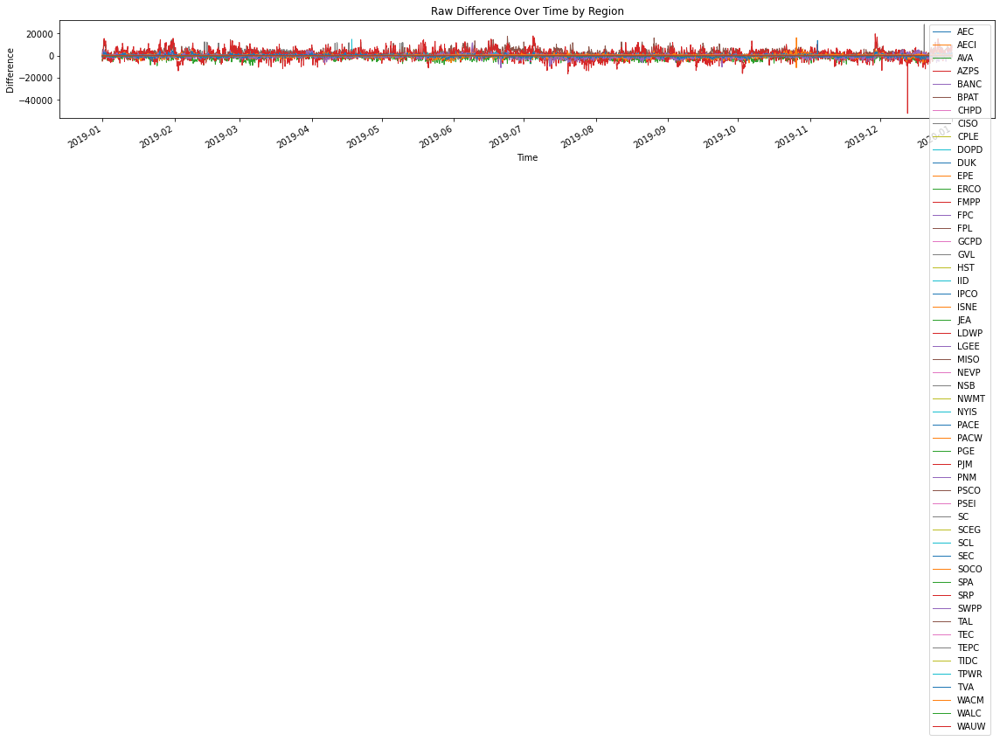

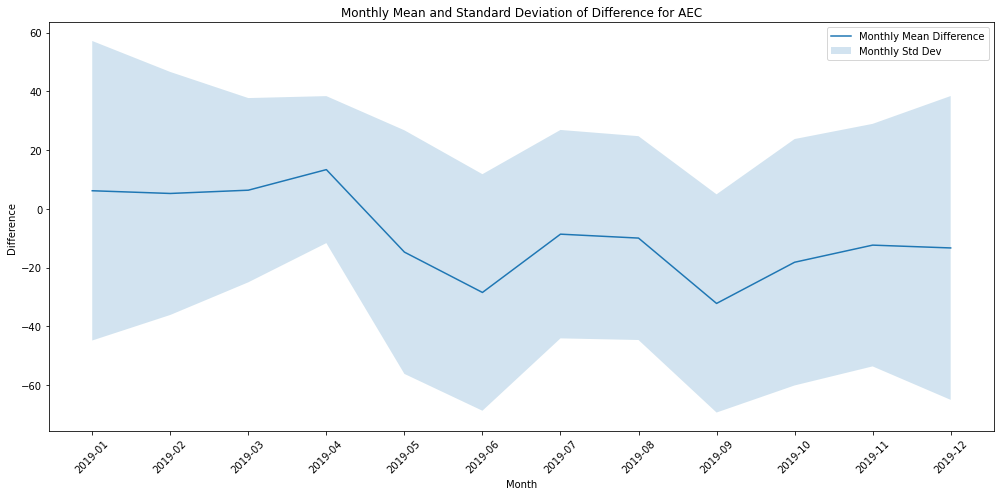

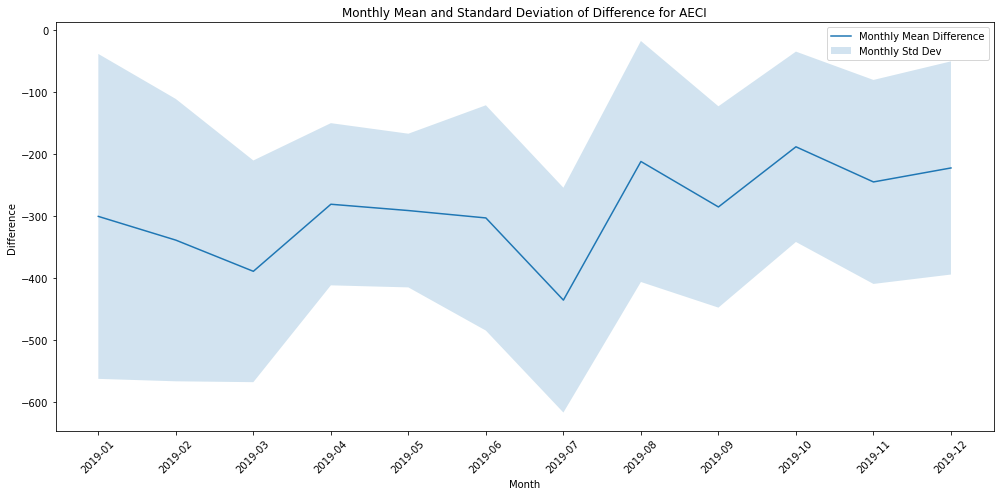

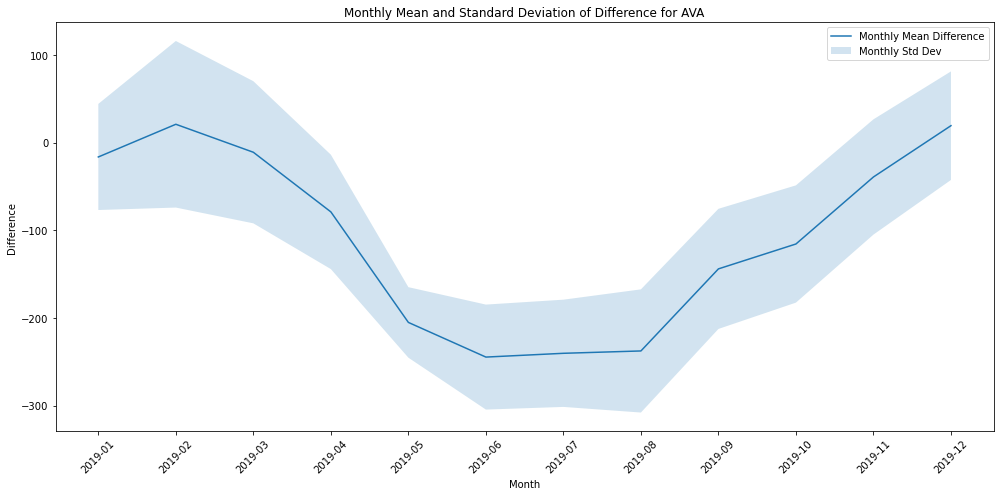

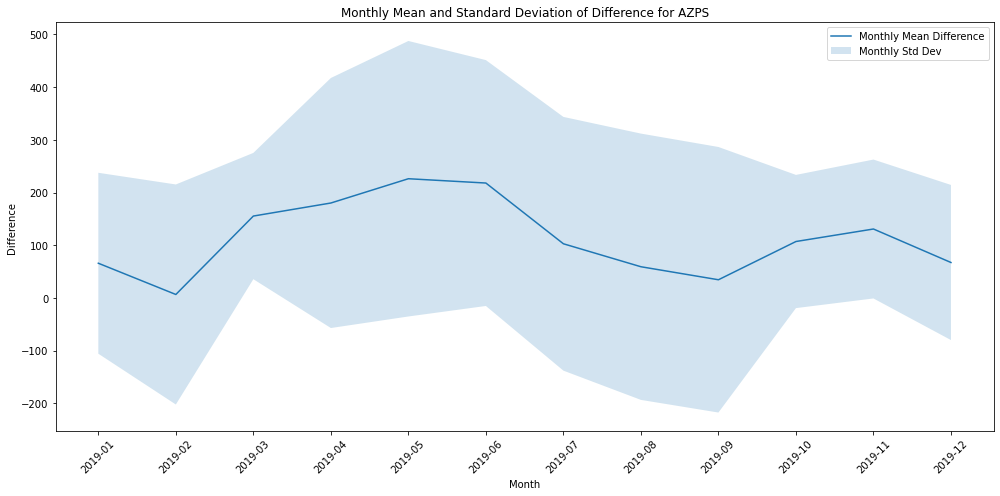

...

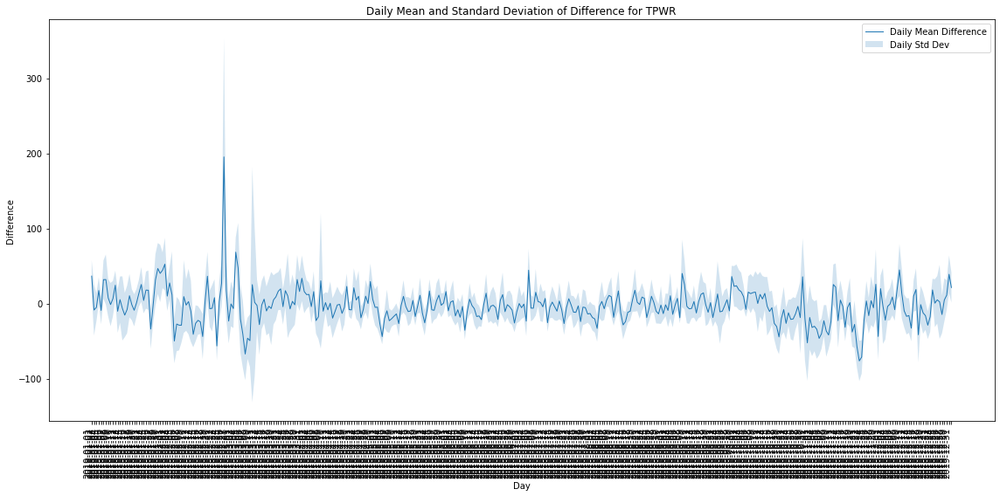

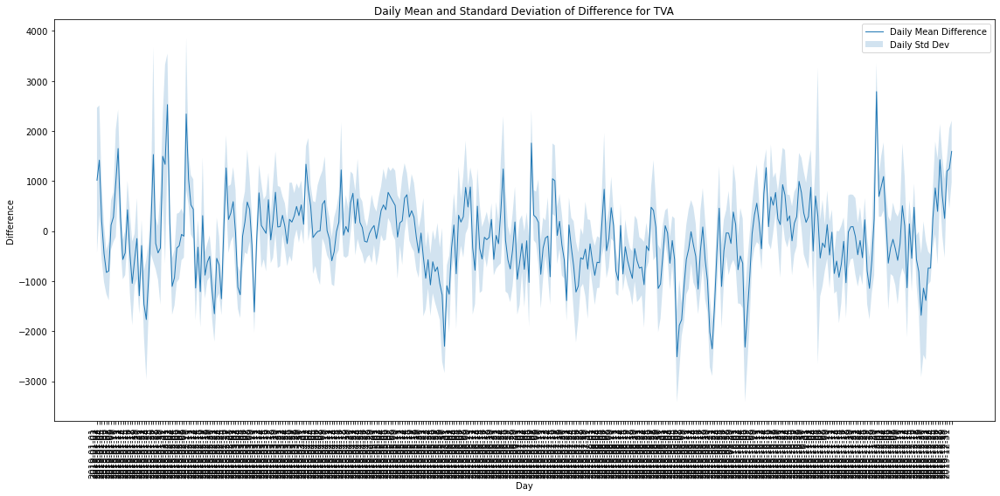

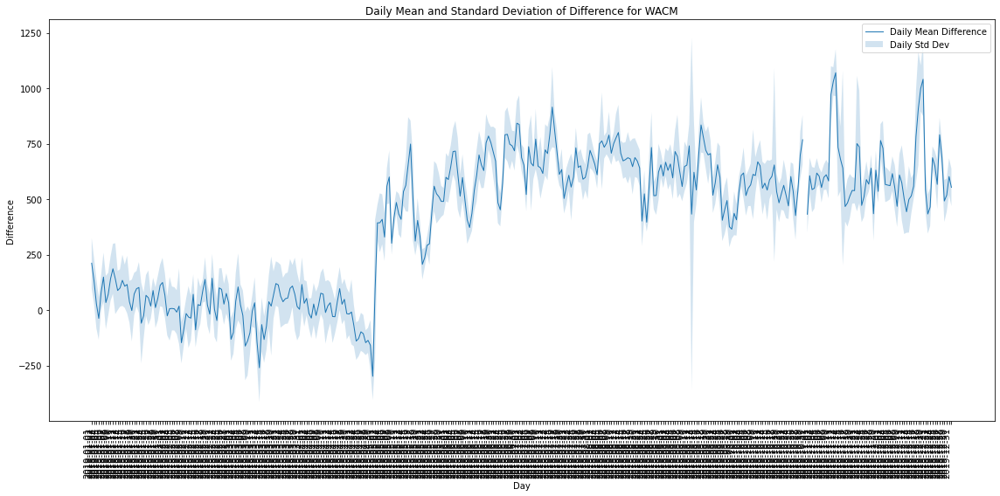

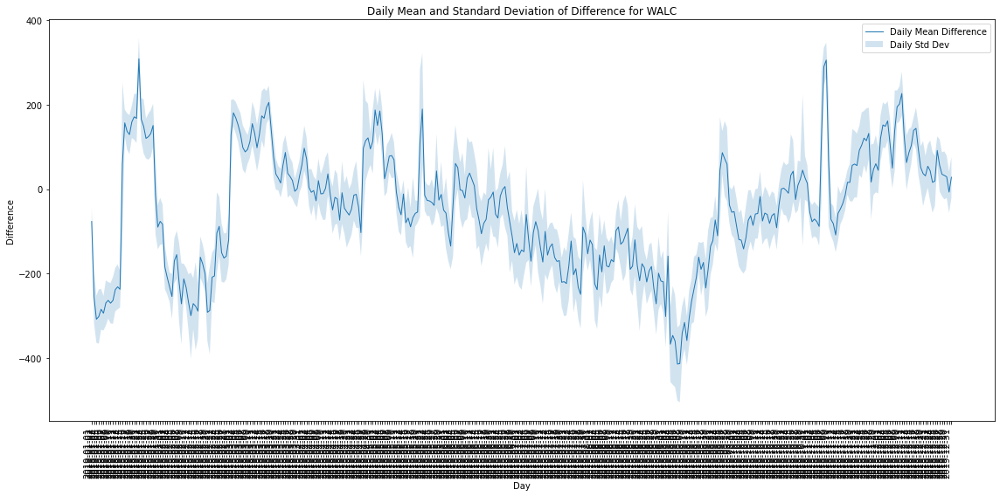

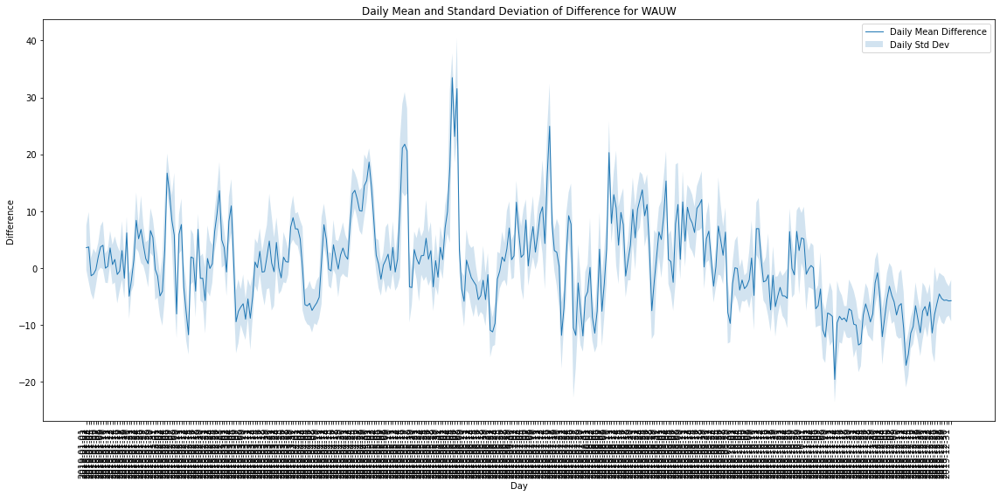

In [74]:
import pandas as pd
import matplotlib.pyplot as plt
import numpy as np
import matplotlib.dates as mdates
# Load the CSV file

df = prediction_df

# Calculate the difference between prediction and ground truth
df['Difference'] = df['predictions'] - df['ground_truth']

# Convert 'datetime' to datetime object for further analysis
df['datetime'] = pd.to_datetime(df['datetime'])

# Extract year-month for monthly analysis and date for daily analysis
df['Month'] = df['datetime'].dt.strftime('%Y-%m')  # Year-Month format
df['Day'] = df['datetime'].dt.strftime('%Y-%m-%d')  # Year-Month-Day format

# Group by Region, then by Month, calculate mean and std of differences
monthly_stats = df.groupby(['region', 'Month'])['Difference'].agg(['mean', 'std']).reset_index()

# Group by Region, then by Day, calculate mean and std of differences
daily_stats = df.groupby(['region', 'Day'])['Difference'].agg(['mean', 'std']).reset_index()
plt.figure(figsize=(16, 8))

for region in df['region'].unique():
    region_df = df[df['region'] == region]
    # Explicitly convert to numpy arrays
    dates = mdates.date2num(region_df['datetime'])  # Convert datetime to Matplotlib's internal date format
    differences = region_df['Difference'].values
    
    plt.plot_date(dates, differences, '-', label=region, linewidth=1)

# Improve the x-axis labels to prevent overcrowding
plt.gca().xaxis.set_major_locator(mdates.MonthLocator())
plt.gca().xaxis.set_major_formatter(mdates.DateFormatter('%Y-%m'))
plt.gcf().autofmt_xdate()  # Auto-format the dates to improve readability

plt.title('Raw Difference Over Time by Region')
plt.xlabel('Time')
plt.ylabel('Difference')
plt.legend()
plt.tight_layout()
plt.show()
# Plotting monthly statistics for each region
for region in df['region'].unique():
    region_monthly_stats = monthly_stats[monthly_stats['region'] == region]
    plt.figure(figsize=(14, 7))
    # Convert to numpy arrays before plotting
    plt.plot(region_monthly_stats['Month'].values, region_monthly_stats['mean'].values, label='Monthly Mean Difference')
    plt.fill_between(region_monthly_stats['Month'].values, 
                     region_monthly_stats['mean'].values - region_monthly_stats['std'].values, 
                     region_monthly_stats['mean'].values + region_monthly_stats['std'].values, 
                     alpha=0.2, label='Monthly Std Dev')
    plt.title(f'Monthly Mean and Standard Deviation of Difference for {region}')
    plt.xlabel('Month')
    plt.ylabel('Difference')
    plt.xticks(rotation=45)
    plt.legend()
    plt.tight_layout()
    plt.show()

# Similar conversion will be needed for daily statistics plotting
for region in df['region'].unique():
    region_daily_stats = daily_stats[daily_stats['region'] == region]
    plt.figure(figsize=(16, 8))
    # Convert to numpy arrays before plotting
    plt.plot(region_daily_stats['Day'].values, region_daily_stats['mean'].values, label='Daily Mean Difference', linewidth=1)
    plt.fill_between(region_daily_stats['Day'].values, 
                     region_daily_stats['mean'].values - region_daily_stats['std'].values, 
                     region_daily_stats['mean'].values + region_daily_stats['std'].values, 
                     alpha=0.2, label='Daily Std Dev')
    plt.title(f'Daily Mean and Standard Deviation of Difference for {region}')
    plt.xlabel('Day')
    plt.ylabel('Difference')
    plt.xticks(rotation=90, ha='right')
    plt.legend()
    plt.tight_layout()
    plt.show()


In [77]:
# Calculate the mean of the predictions by region
mean_by_region = df.groupby('region')['predictions'].mean().reset_index()

# Display the mean differences by region
print(mean_by_region)


   region   predictions
0     AEC    527.318183
1    AECI   2388.952379
2     AVA   1363.815205
3    AZPS   3497.615626
4    BANC   1991.128552
5    BPAT   6282.317217
6    CHPD    203.910800
7    CISO  25799.798821
8    CPLE   6929.869715
9    DOPD    182.106626
10    DUK  11938.078260
11    EPE    973.834474
12   ERCO  42119.527111
13   FMPP   2061.479347
14    FPC   6241.062816
15    FPL  14572.596672
16   GCPD    567.353183
17    GVL    241.062395
18    HST     65.276726
19    IID    410.053749
20   IPCO   1942.157987
21   ISNE  13923.671245
22    JEA   1476.325563
23   LDWP   3221.509398
24   LGEE   4159.129990
25   MISO  76619.835008
26   NEVP   4273.136052
27    NSB     50.422390
28   NWMT   1296.417578
29   NYIS  18227.237103
30   PACE   5428.906136
31   PACW   2348.254055
32    PGE   2303.576521
33    PJM  92210.662207
34    PNM   1596.028486
35   PSCO   5030.854860
36   PSEI   3393.845299
37     SC   2789.405638
38   SCEG   2796.497528
39    SCL   1109.737201
40    SEC    165

In [78]:
# Calculate the mean of the differences by region
mean_by_region = df.groupby('region')['Difference'].mean().reset_index()

# Display the mean differences by region
print(mean_by_region)

   region   Difference
0     AEC    -8.927593
1    AECI  -290.999105
2     AVA  -108.542444
3    AZPS   113.288685
4    BANC    40.830721
5    BPAT   -93.864404
6    CHPD    -6.407122
7    CISO  1351.988661
8    CPLE  -149.384737
9    DOPD   -24.245542
10    DUK  -252.415690
11    EPE    -0.712558
12   ERCO -1677.356451
13   FMPP    21.859598
14    FPC    14.645236
15    FPL   -67.829584
16   GCPD   -44.911543
17    GVL     4.131578
18    HST    -1.741539
19    IID    -1.708580
20   IPCO     2.962991
21   ISNE   420.837911
22    JEA   -19.837958
23   LDWP   157.685734
24   LGEE   195.826109
25   MISO  2474.699620
26   NEVP    18.061966
27    NSB    -0.126358
28   NWMT  -131.052856
29   NYIS   439.814272
30   PACE  -132.049572
31   PACW   -15.527109
32    PGE   -42.285350
33    PJM   852.496111
34    PNM     0.390016
35   PSCO  -429.808838
36   PSEI    19.856372
37     SC   336.433587
38   SCEG   -15.330897
39    SCL    30.941995
40    SEC   117.900147
41   SOCO  -387.966033
42    SPA  

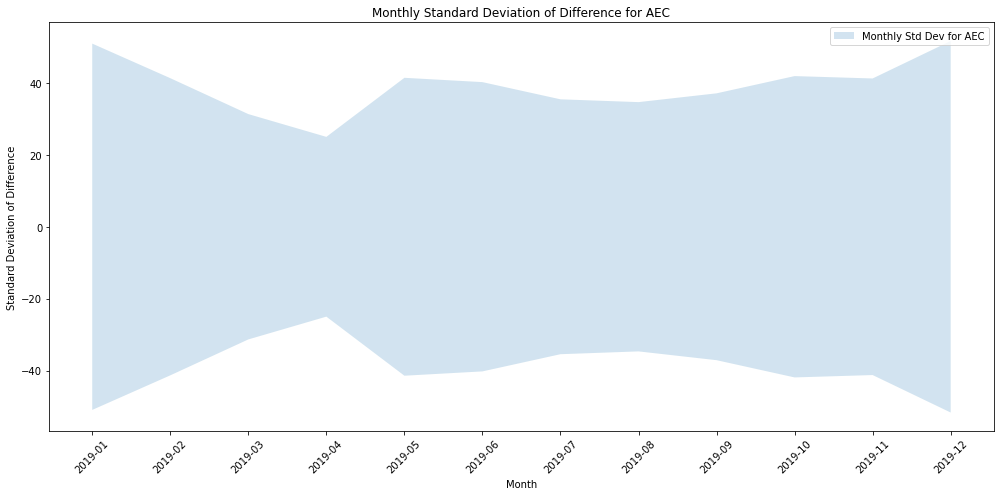

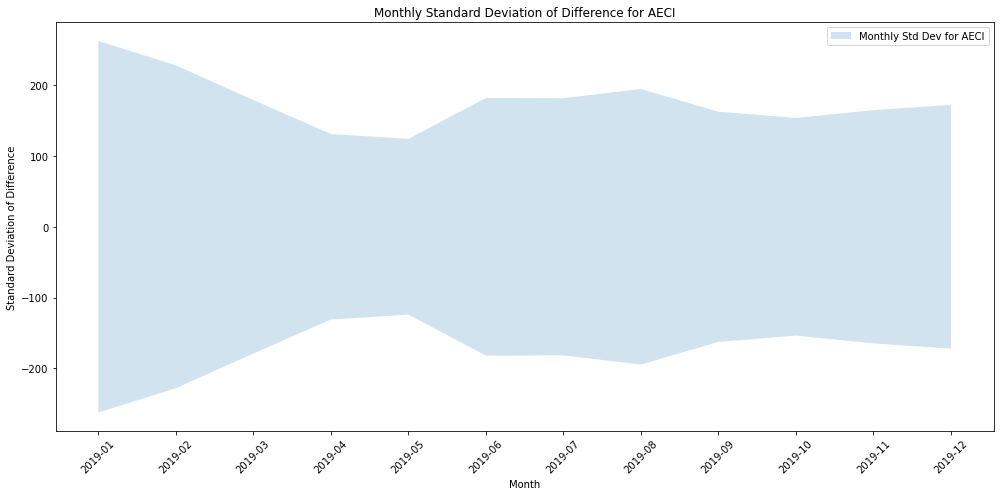

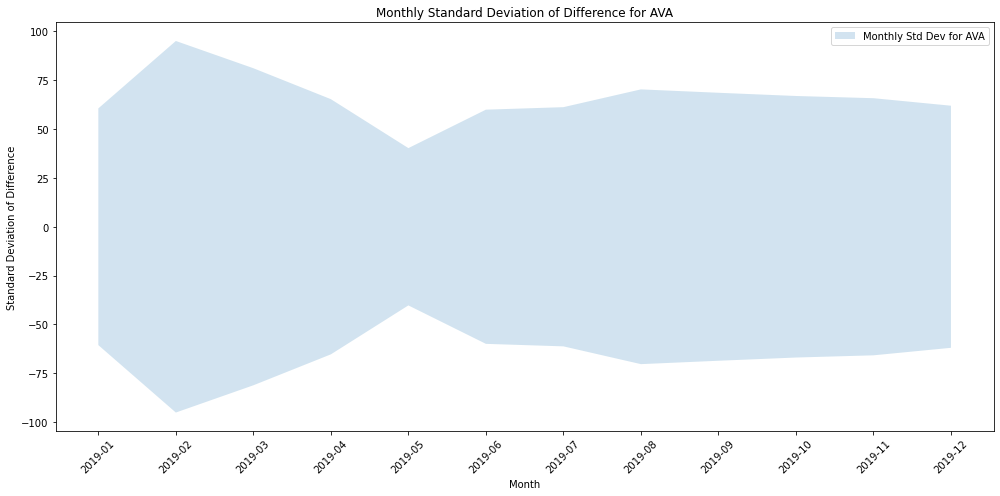

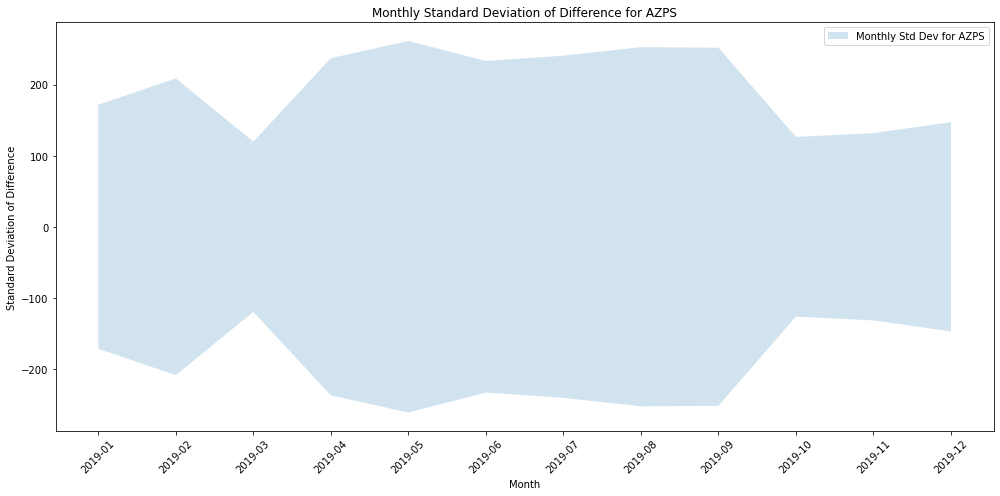

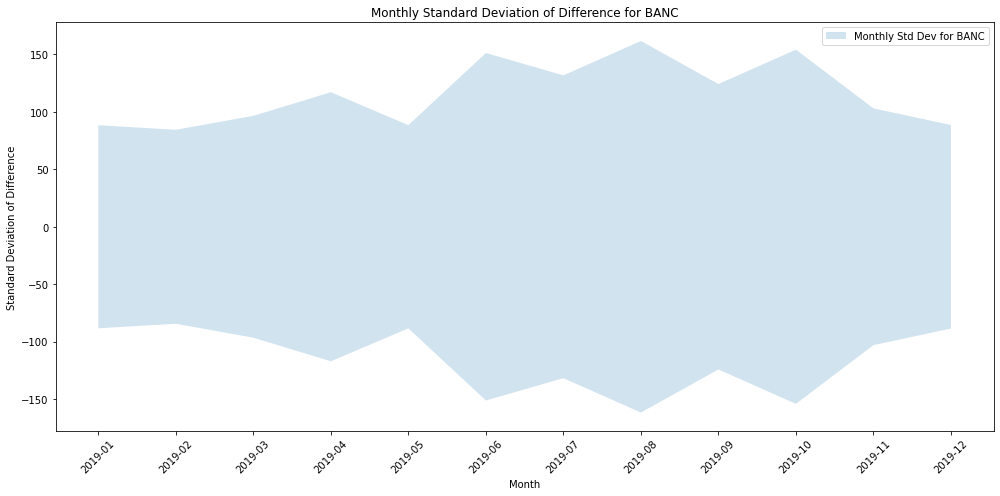

...

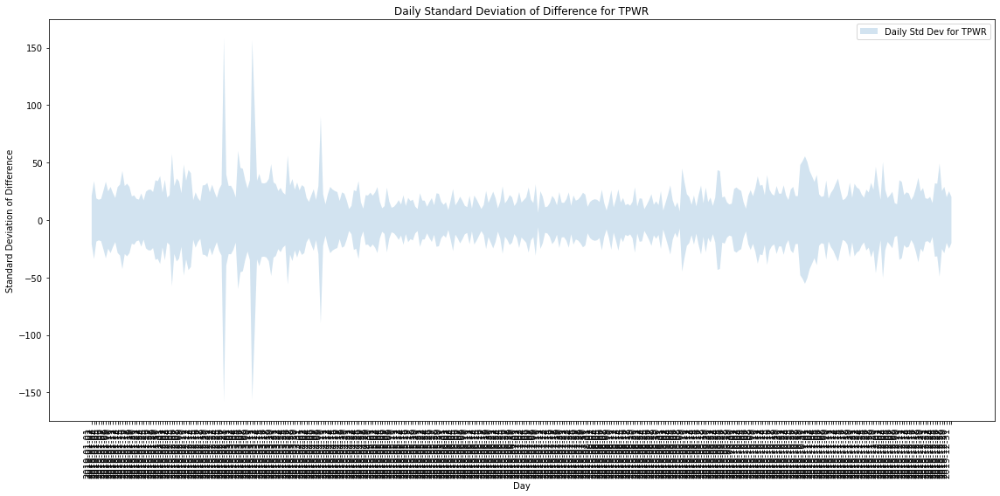

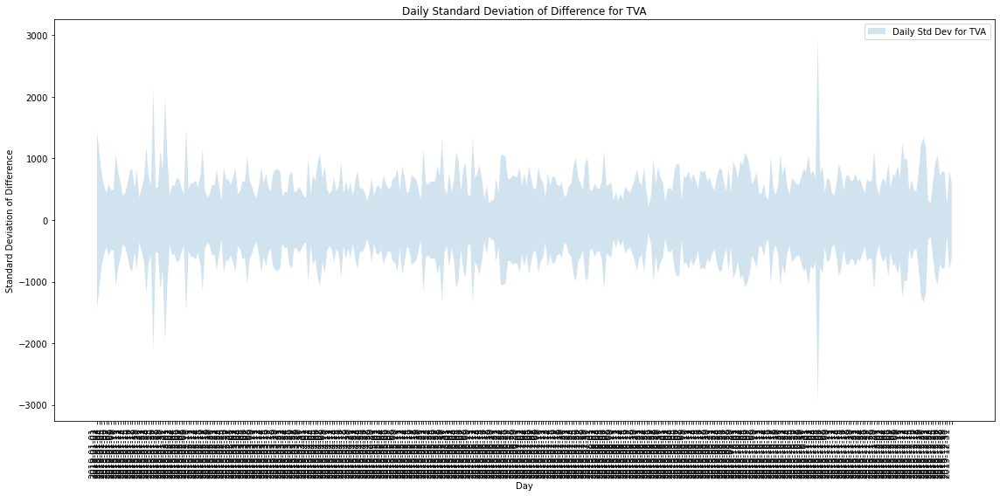

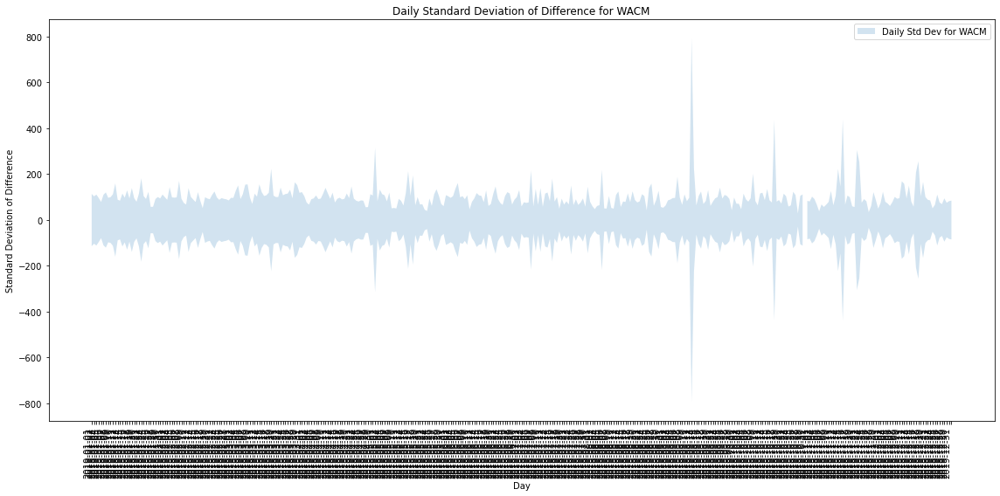

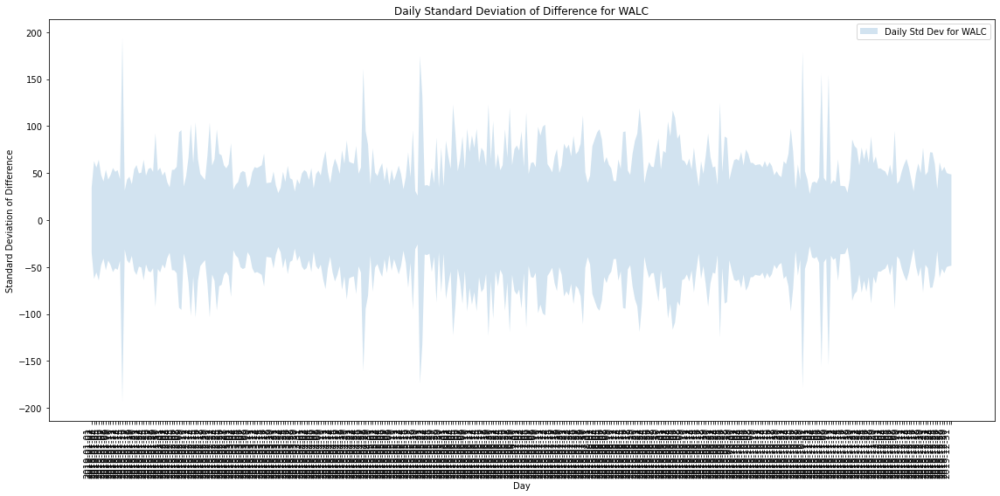

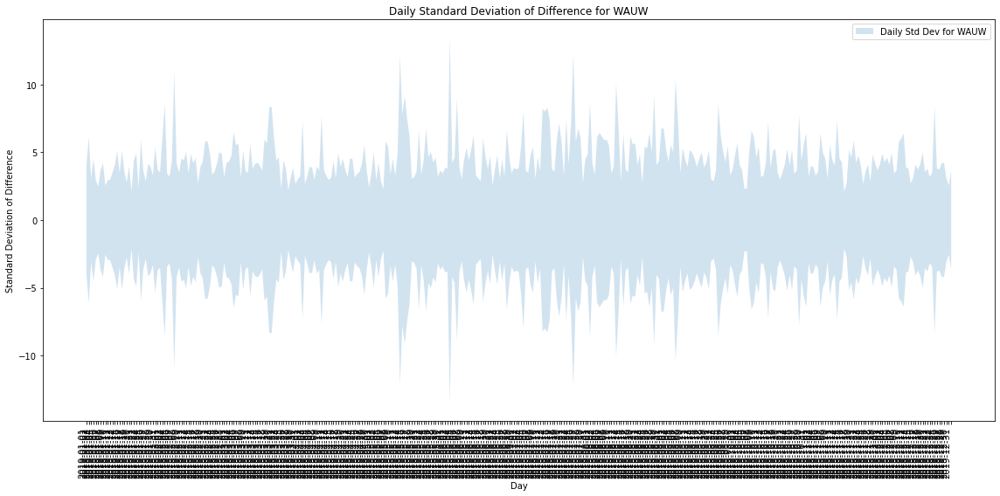

In [79]:
import matplotlib.pyplot as plt

# Plotting monthly standard deviation for each region
for region in df['region'].unique():
    region_monthly_stats = monthly_stats[monthly_stats['region'] == region]
    plt.figure(figsize=(14, 7))
    # Plotting only the magnitude of standard deviation
    plt.fill_between(region_monthly_stats['Month'].values, 
                     -region_monthly_stats['std'].values, 
                     region_monthly_stats['std'].values, 
                     alpha=0.2, label=f'Monthly Std Dev for {region}')
    plt.title(f'Monthly Standard Deviation of Difference for {region}')
    plt.xlabel('Month')
    plt.ylabel('Standard Deviation of Difference')
    plt.xticks(rotation=45)
    plt.legend()
    plt.tight_layout()
    plt.show()

# Plotting daily standard deviation for each region
for region in df['region'].unique():
    region_daily_stats = daily_stats[daily_stats['region'] == region]
    plt.figure(figsize=(16, 8))
    # Plotting only the magnitude of standard deviation
    plt.fill_between(region_daily_stats['Day'].values, 
                     -region_daily_stats['std'].values, 
                     region_daily_stats['std'].values, 
                     alpha=0.2, label=f'Daily Std Dev for {region}')
    plt.title(f'Daily Standard Deviation of Difference for {region}')
    plt.xlabel('Day')
    plt.ylabel('Standard Deviation of Difference')
    plt.xticks(rotation=90, ha='right')
    plt.legend()
    plt.tight_layout()
    plt.show()


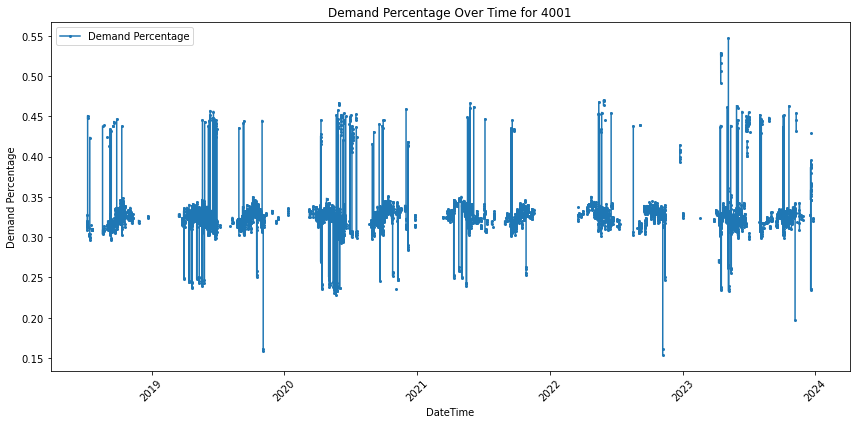

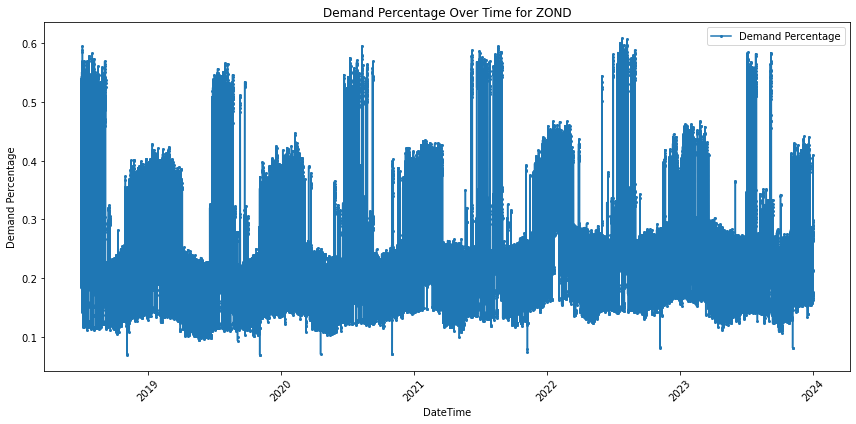

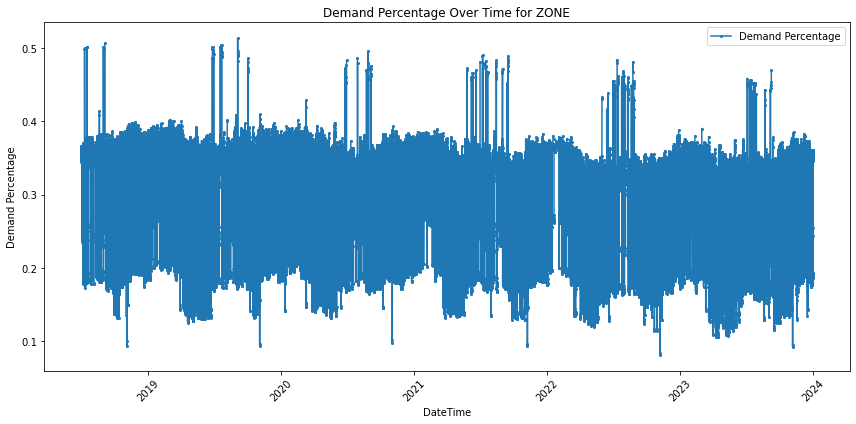

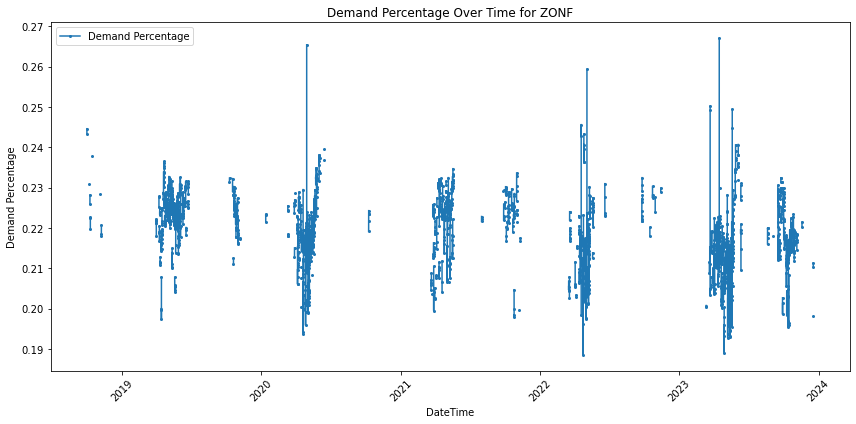

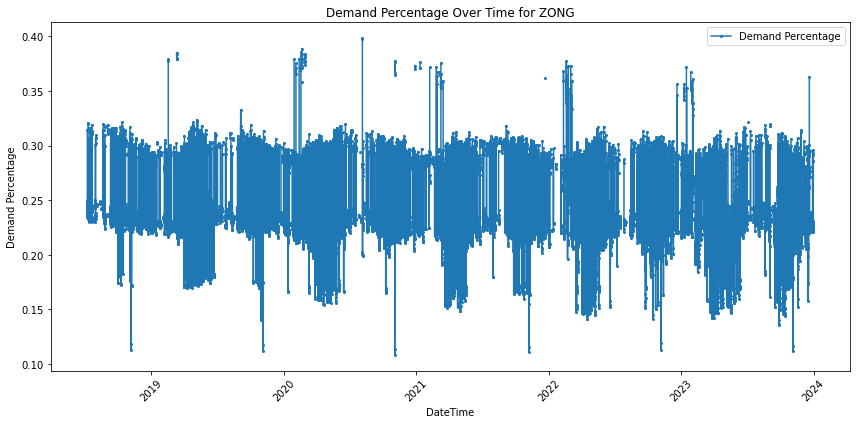

...

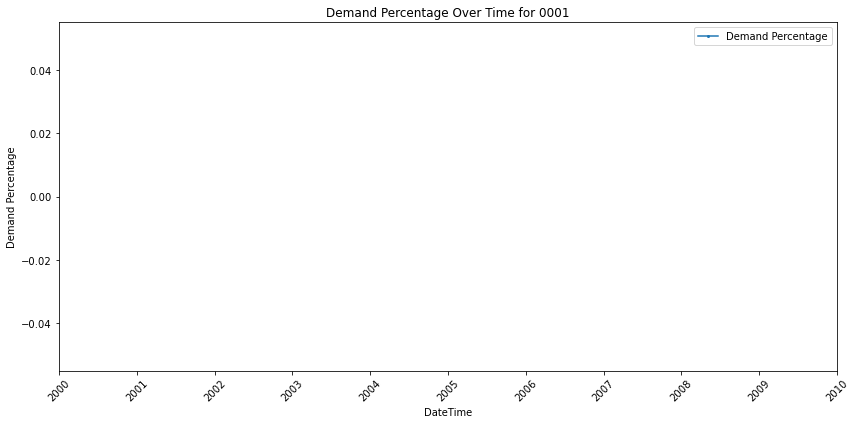

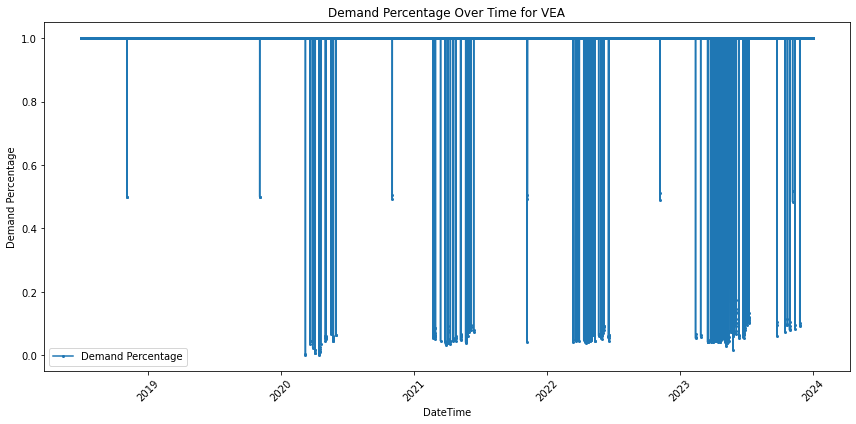

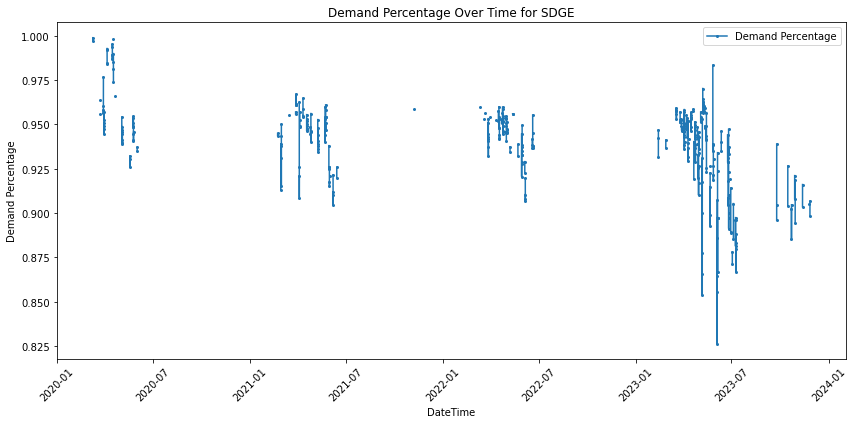

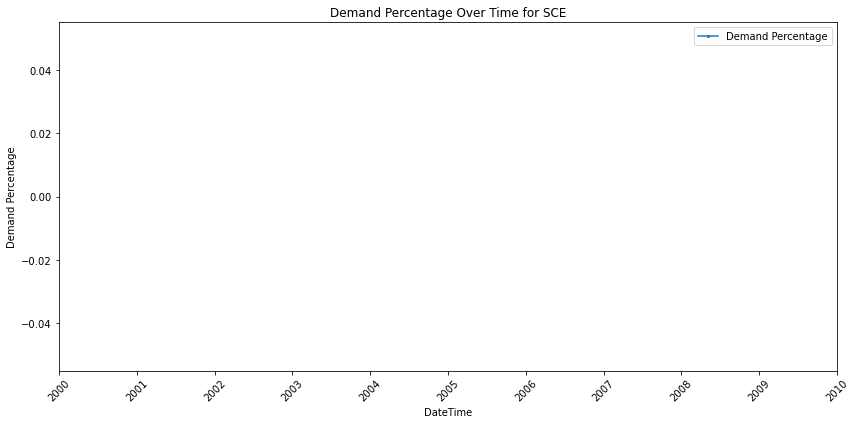

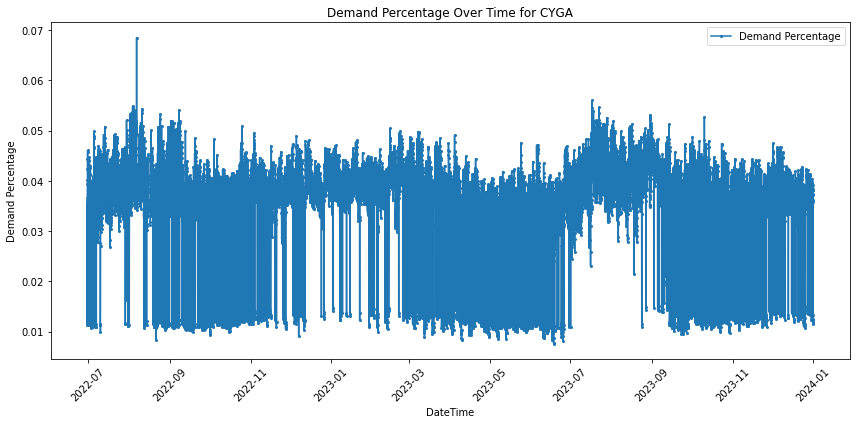

In [91]:
import pandas as pd
import os
import matplotlib.pyplot as plt
import glob

def load_and_process_data(folder_path):
    all_files = glob.glob(os.path.join(folder_path, "*.csv"))
    df_list = [pd.read_csv(file) for file in all_files]
    df = pd.concat(df_list, ignore_index=True)
    
    df['Demand (MW)'] = pd.to_numeric(df['Demand (MW)'], errors='coerce')
    df['Data Date'] = pd.to_datetime(df['Data Date'])

    # Adjust for any 'Hour Number' beyond "23"
    def adjust_datetime(row):
        hour = int(row['Hour Number'])
        if hour >= 24:
            adjusted_date = row['Data Date'] + pd.Timedelta(days=1)
            adjusted_hour = hour - 24
            return pd.to_datetime(adjusted_date.strftime('%Y-%m-%d') + f' {adjusted_hour:02d}:00')
        else:
            return pd.to_datetime(row['Data Date'].strftime('%Y-%m-%d') + f' {hour:02d}:00')

    df['DateTime'] = df.apply(adjust_datetime, axis=1)
    
    df.sort_values(by=['DateTime'], inplace=True)
    
    df['Total Demand (MW)'] = df.groupby(['DateTime', 'Balancing Authority'])['Demand (MW)'].transform('sum')
    df['Demand Percentage'] = df['Demand (MW)'] / df['Total Demand (MW)']
    
    return df



def plot_demand_percentage_by_subregion(df):
    # Generate graphs for each subregion to visualize how the percentage changes over time
    subregions = df['Sub-Region'].unique()
    for subregion in subregions:
        subregion_df = df[df['Sub-Region'] == subregion]
        plt.figure(figsize=(12, 6))
        # Use the 'DateTime' column for plotting
        dates = subregion_df['DateTime'].values
        percentages = subregion_df['Demand Percentage'].values
        plt.plot(dates, percentages, label='Demand Percentage', marker='o', linestyle='-', markersize=2)
        plt.title(f'Demand Percentage Over Time for {subregion}')
        plt.xlabel('DateTime')
        plt.ylabel('Demand Percentage')
        plt.xticks(rotation=45)
        plt.tight_layout()
        plt.legend()
        plt.show()


# Example usage
folder_path = r'/Users/ansonkong/Downloads/project_data/subregion_data'  # Update this to the path where your CSV files are stored
df = load_and_process_data(folder_path)
plot_demand_percentage_by_subregion(df)


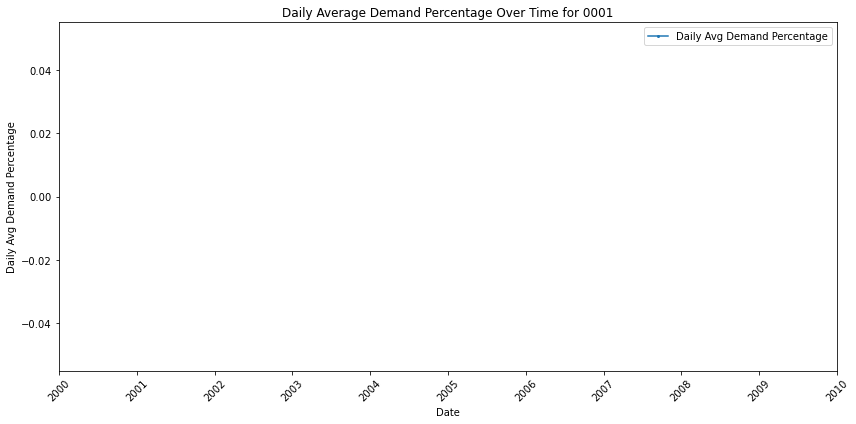

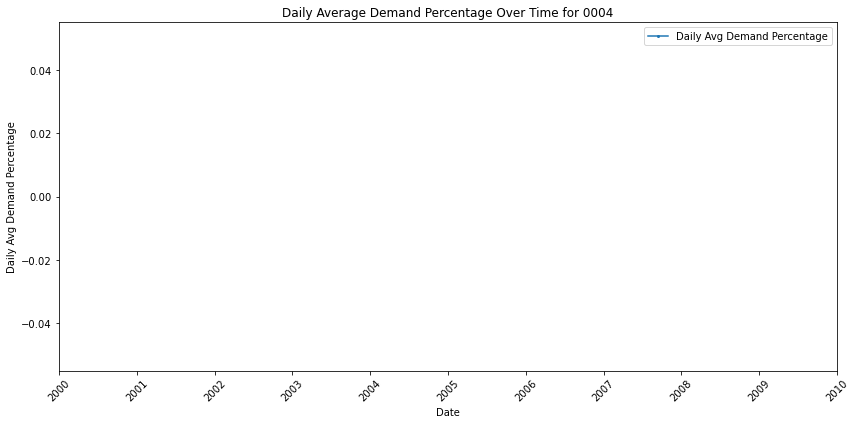

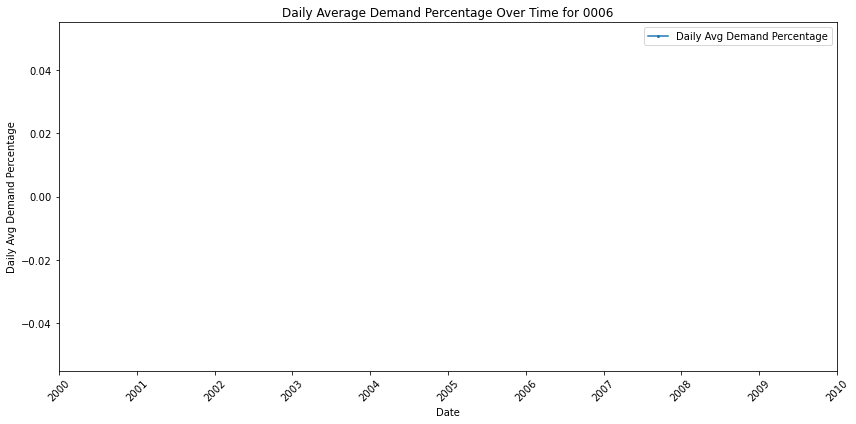

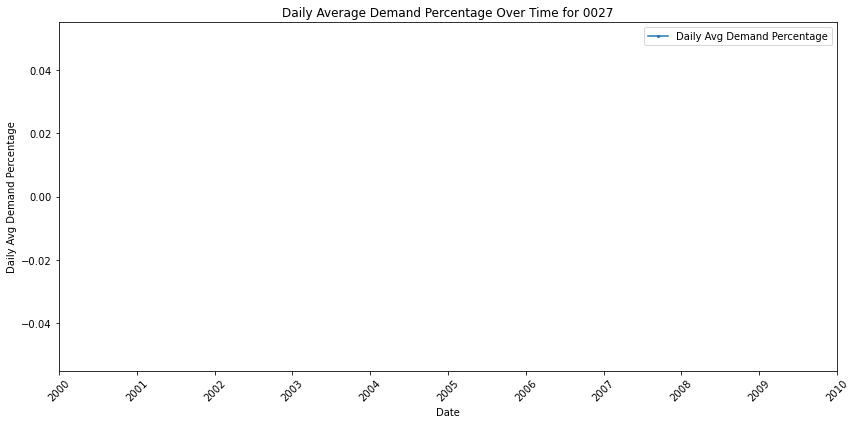

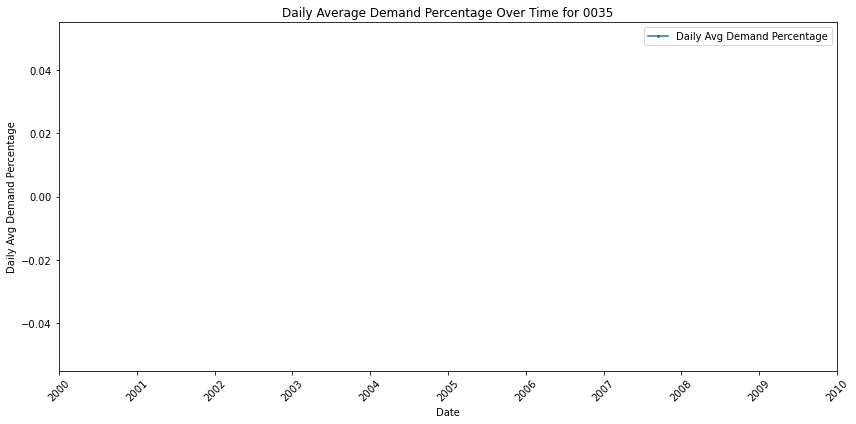

...

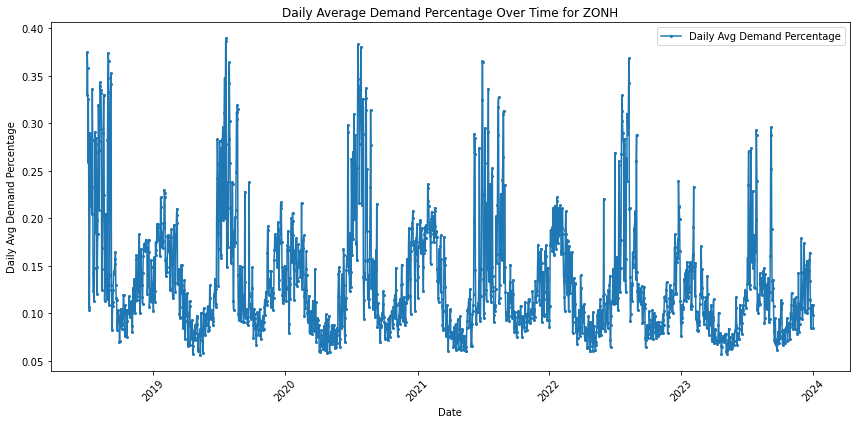

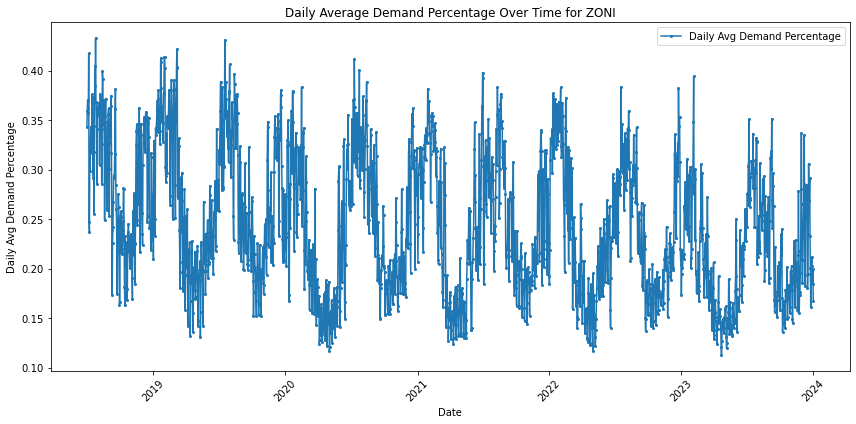

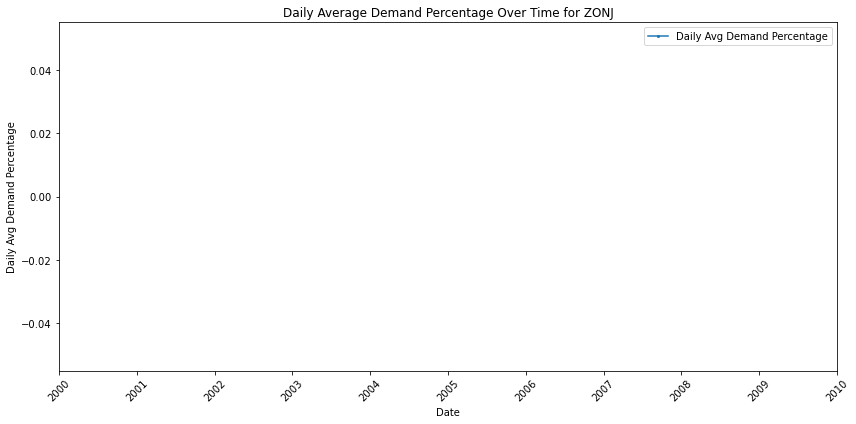

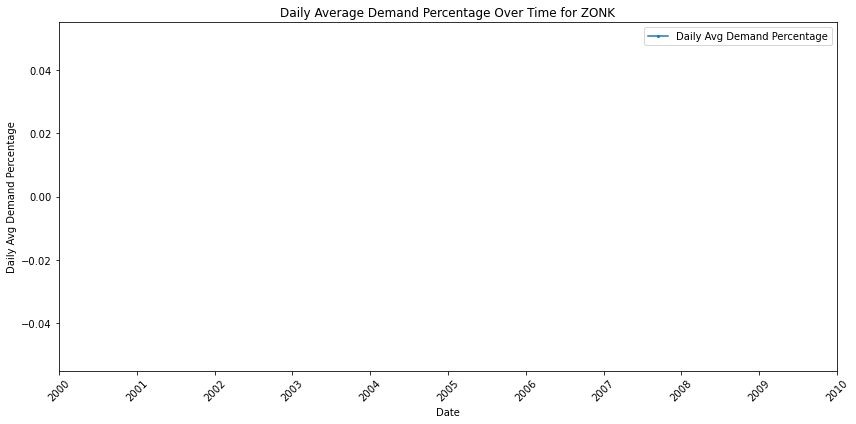

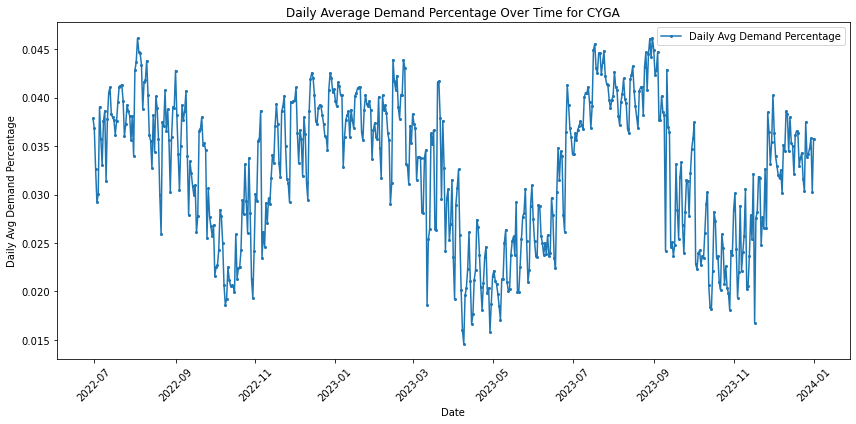

In [94]:
def calculate_daily_average(df):
    # Assuming 'DateTime' column is already in your DataFrame and is of datetime type
    # Extract just the date part for daily aggregation
    df['Date'] = df['DateTime'].dt.date
    
    # Calculate daily average 'Demand Percentage' for each 'Sub-Region'
    daily_avg_df = df.groupby(['Date', 'Sub-Region'])['Demand Percentage'].mean().reset_index()
    
    return daily_avg_df
def plot_daily_average_demand_percentage(daily_avg_df):
    subregions = daily_avg_df['Sub-Region'].unique()
    for subregion in subregions:
        subregion_daily_avg = daily_avg_df[daily_avg_df['Sub-Region'] == subregion]
        plt.figure(figsize=(12, 6))
        # Explicitly convert DataFrame columns to numpy arrays
        dates = pd.to_datetime(subregion_daily_avg['Date']).values
        percentages = subregion_daily_avg['Demand Percentage'].values
        plt.plot(dates, percentages, label='Daily Avg Demand Percentage', marker='o', linestyle='-', markersize=2)
        plt.title(f'Daily Average Demand Percentage Over Time for {subregion}')
        plt.xlabel('Date')
        plt.ylabel('Daily Avg Demand Percentage')
        plt.xticks(rotation=45)
        plt.tight_layout()
        plt.legend()
        plt.show()


# Calculate daily average demand percentage
daily_avg_df = calculate_daily_average(df)

# Plot the daily average demand percentage for each subregion
plot_daily_average_demand_percentage(daily_avg_df)


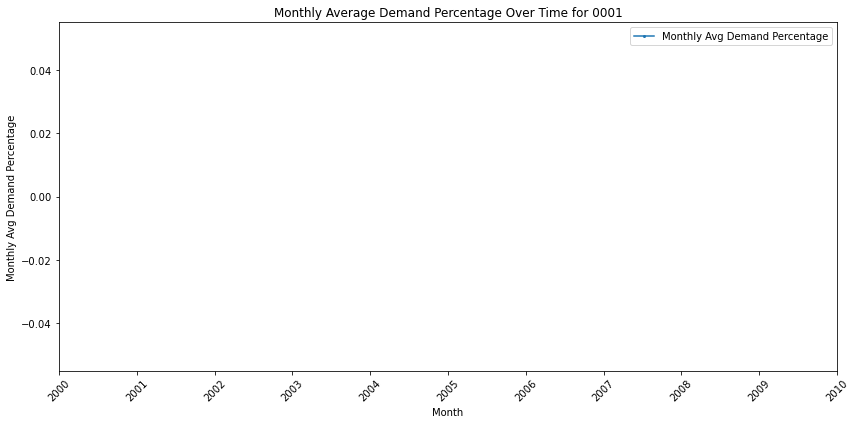

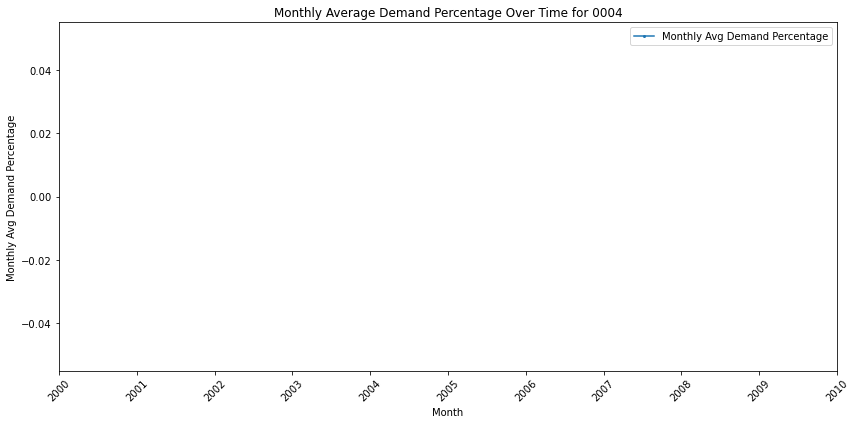

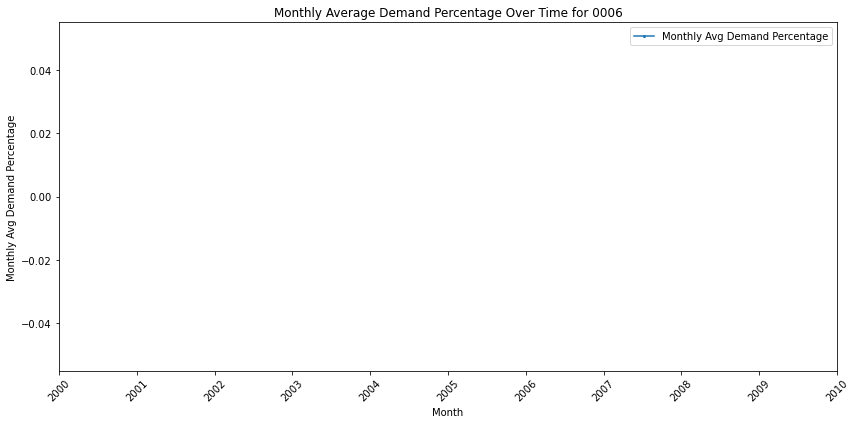

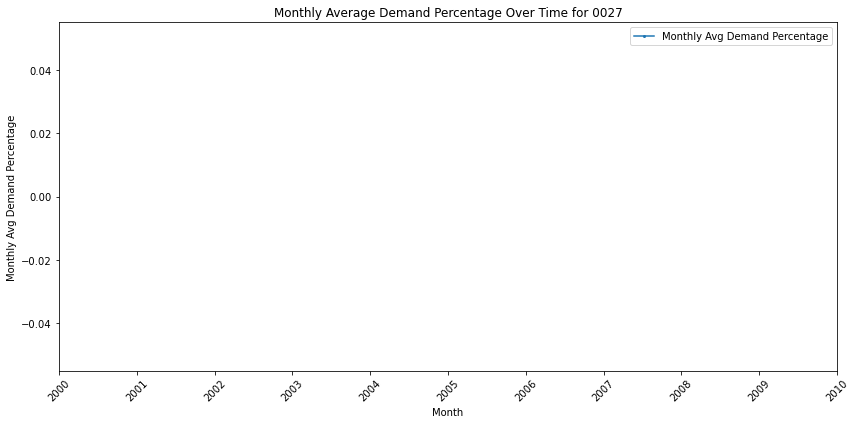

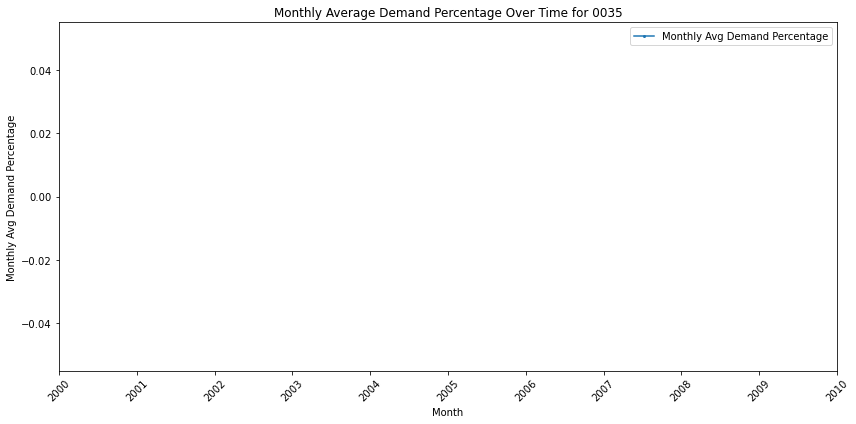

...

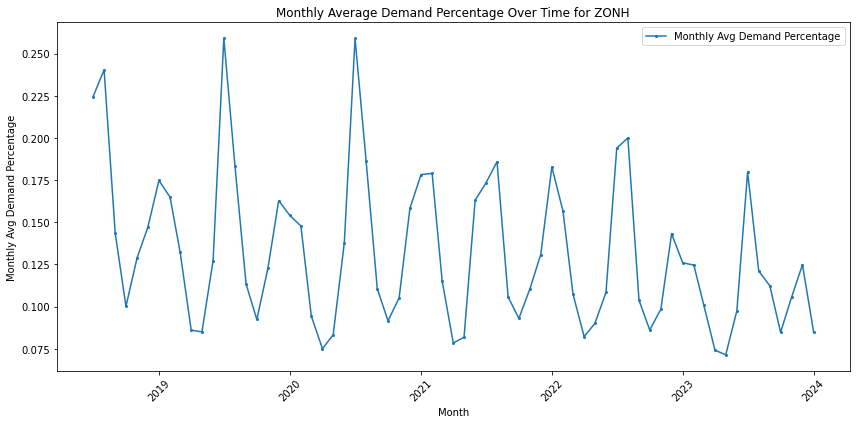

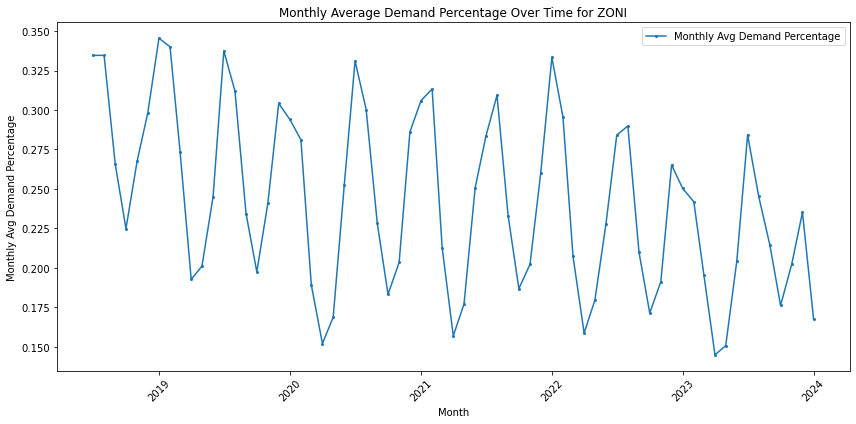

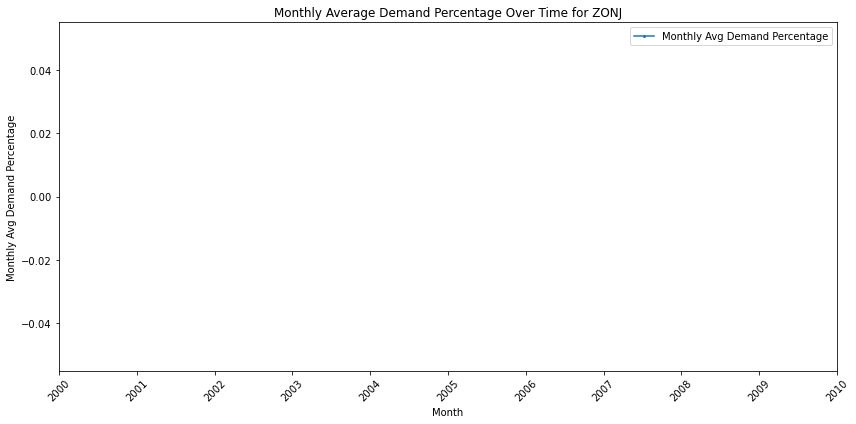

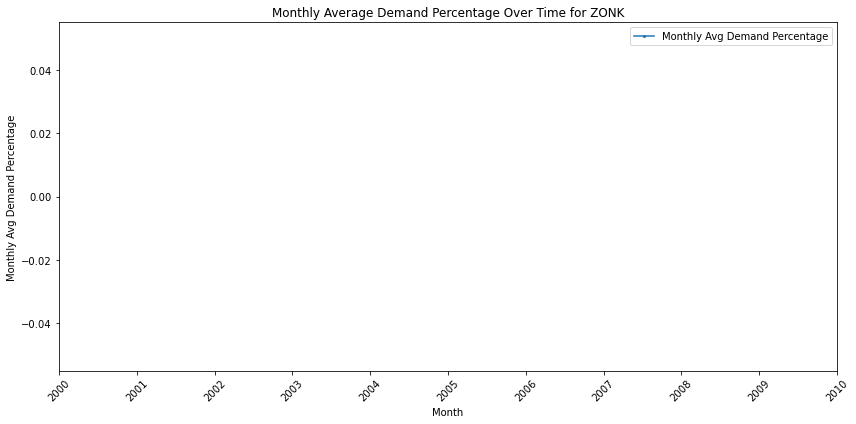

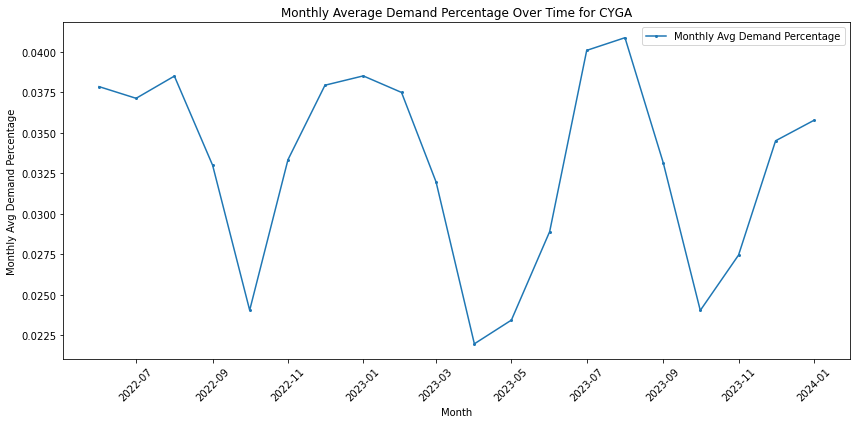

In [97]:
def calculate_monthly_average(df):
    # Assuming 'DateTime' column is already in your DataFrame and is of datetime type
    # Extract just the year and month part for monthly aggregation
    df['YearMonth'] = df['DateTime'].dt.to_period('M')
    
    # Calculate monthly average 'Demand Percentage' for each 'Sub-Region'
    monthly_avg_df = df.groupby(['YearMonth', 'Sub-Region'])['Demand Percentage'].mean().reset_index()
    
    # Convert YearMonth back to datetime for plotting
    monthly_avg_df['YearMonth'] = monthly_avg_df['YearMonth'].dt.to_timestamp()
    
    return monthly_avg_df
def plot_monthly_average_demand_percentage(monthly_avg_df):
    subregions = monthly_avg_df['Sub-Region'].unique()
    for subregion in subregions:
        subregion_monthly_avg = monthly_avg_df[monthly_avg_df['Sub-Region'] == subregion]
        plt.figure(figsize=(12, 6))
        # The 'YearMonth' column is already in datetime format
        dates = subregion_monthly_avg['YearMonth'].values
        percentages = subregion_monthly_avg['Demand Percentage'].values
        plt.plot(dates, percentages, label='Monthly Avg Demand Percentage', marker='o', linestyle='-', markersize=2)
        plt.title(f'Monthly Average Demand Percentage Over Time for {subregion}')
        plt.xlabel('Month')
        plt.ylabel('Monthly Avg Demand Percentage')
        plt.xticks(rotation=45)
        plt.tight_layout()
        plt.legend()
        plt.show()

# Calculate monthly average demand percentage
monthly_avg_df = calculate_monthly_average(df)

# Plot the monthly average demand percentage for each subregion
plot_monthly_average_demand_percentage(monthly_avg_df)

/var/folders/8v/68yqll_54lzgb57b5q8_fbrc0000gn/T/ipykernel_38351/1107868513.py:17: UserWarning: Geometry is in a geographic CRS. Results from 'centroid' are likely incorrect. Use 'GeoSeries.to_crs()' to re-project geometries to a projected CRS before this operation.

  agg_subregions['centroid'] = agg_subregions.geometry.centroid


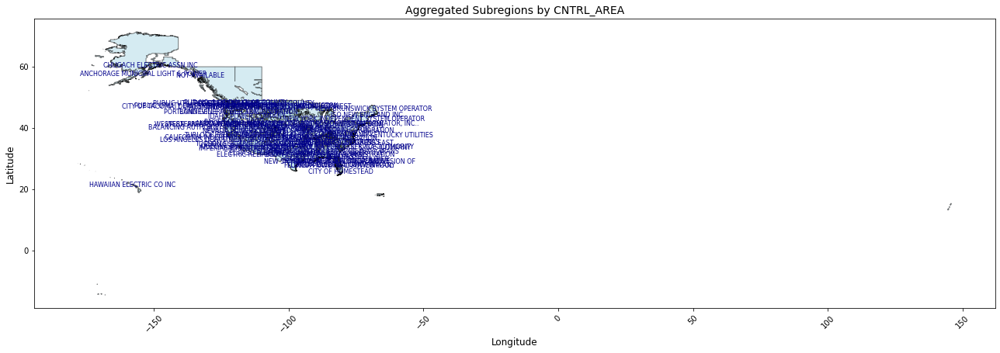

In [99]:
import geopandas as gpd
import matplotlib.pyplot as plt

# Load the shapefile
shapefile_path = '/Users/ansonkong/Downloads/Electric_Retail_Service_Territories/Electric_Retail_Service_Territories.shp'


ba_subregions = gpd.read_file(shapefile_path)

# Ensure column names have no spaces for easier access
ba_subregions.columns = [col.replace(' ', '_') for col in ba_subregions.columns]

# Aggregate (dissolve) geometries by 'CNTRL_AREA'
agg_subregions = ba_subregions.dissolve(by='CNTRL_AREA', as_index=False)

# Calculate centroids of aggregated geometries for annotations
agg_subregions['centroid'] = agg_subregions.geometry.centroid

def plot_aggregated_subregions_with_annotations(gdf, title):
    fig, ax = plt.subplots(figsize=(18, 10))
    # Plot aggregated geometries
    gdf.plot(ax=ax, color='lightblue', edgecolor='black', alpha=0.5)
    
    # Annotate using the 'centroid' for positioning
    for idx, row in gdf.iterrows():
        # Using 'CNTRL_AREA' for annotation text
        ax.text(row['centroid'].x, row['centroid'].y, row['CNTRL_AREA'], 
                fontsize=8, ha='center', va='center', color='darkblue')
    
    ax.set_title(title, fontsize=14)
    ax.set_xlabel('Longitude', fontsize=12)
    ax.set_ylabel('Latitude', fontsize=12)
    plt.xticks(rotation=45, fontsize=10)
    plt.yticks(fontsize=10)
    plt.tight_layout()
    plt.show()

# Plot the aggregated subregions with annotations by 'CNTRL_AREA'
plot_aggregated_subregions_with_annotations(agg_subregions, 'Aggregated Subregions by CNTRL_AREA')

/opt/anaconda3/lib/python3.9/site-packages/IPython/core/interactiveshell.py:3309: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  if await self.run_code(code, result, async_=asy):


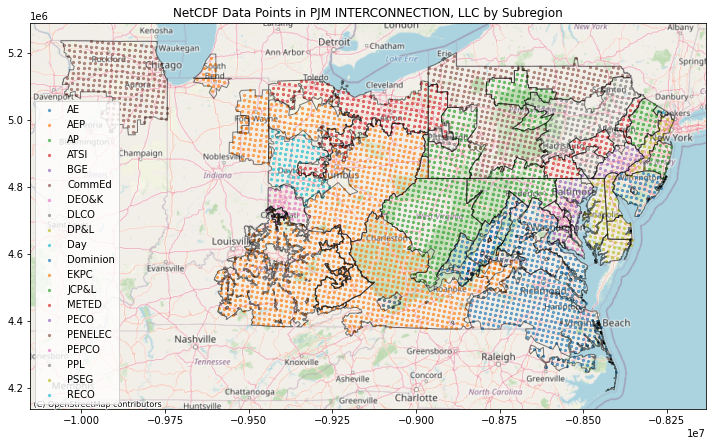

In [105]:
import geopandas as gpd
import matplotlib.pyplot as plt
import netCDF4 as nc
import numpy as np
import pandas as pd
from shapely.geometry import Point
import contextily as ctx

control_area_mapping = {
    "CommEd": ["COMMONWEALTH EDISON CO"],
    "EKPC": ["EAST KENTUCKY POWER COOP, INC"],
    "DEO&K": ["DUKE ENERGY KENTUCKY", "DUKE ENERGY OHIO INC"],
    "Day": ["DAYTON POWER & LIGHT CO"],
    "ATSI": ["THE TOLEDO EDISON CO", "OHIO EDISON CO", "PENNSYLVANIA POWER CO"],
    "OVEC": ["OHIO VALLEY ELECTRIC CORP"],
    "AEP": ["OHIO POWER CO", "KENTUCKY POWER CO", "APPALACHIAN POWER CO","TOWN OF WARREN - (IN)","CITY OF NILES - (MI)","INDIANA MICHIGAN POWER CO","CENTRAL VIRGINIA ELECTRIC COOP"],
    "AP": ["WEST PENN POWER COMPANY", "MONONGAHELA POWER CO","THE POTOMAC EDISON COMPANY"],
    "Dominion": ["VIRGINIA ELECTRIC & POWER CO", "RAPPAHANNOCK ELECTRIC COOP","SHENANDOAH VALLEY ELEC COOP","BARC ELECTRIC COOP INC"],
    "DP&L": ["MONONGAHELA POWER CO", "CITY OF SEAFORD- (DE)", "TOWN OF SMYRNA - (DE)", "CHOPTANK ELECTRIC COOPERATIVE, INC"],
    "PEPCO": ["SOUTHERN MARYLAND ELEC COOP INC", "POTOMAC ELECTRIC POWER CO"],
    "BGE": ["BALTIMORE GAS & ELECTRIC CO"],
    "AE": ["ATLANTIC CITY ELECTRIC CO", "CITY OF VINELAND - (NJ)"],
    "JCP&L": ["JERSEY CENTRAL POWER & LT CO"],
    "PSEG": ["PUBLIC SERVICE ELEC & GAS CO"],
    "RECO": ["ROCKLAND ELECTRIC CO"],
    "PECO": ["PECO ENERGY CO"],
    "METED": ["METROPOLITAN EDISON CO"],
    "PPL": ["PPL ELECTRIC UTILITIES CORP"],
    "PENELEC": ["PENNSYLVANIA ELECTRIC CO"],
    "DLCO": ["DUQUESNE LIGHT CO"]
}

# Function to map NAME to subregion
def map_name_to_subregion(name):
    for subregion, names in control_area_mapping.items():
        if name in names:
            return subregion
    return None
# Load and filter the shapefile for subregions, include "NOT AVAILABLE"
shapefile_path =  '/Users/ansonkong/Downloads/Electric_Retail_Service_Territories/Electric_Retail_Service_Territories.shp'
ba_subregions = gpd.read_file(shapefile_path)
ba_subregions = ba_subregions[(ba_subregions['CNTRL_AREA'] == 'PJM INTERCONNECTION, LLC') | (ba_subregions['CNTRL_AREA'] == 'NOT AVAILABLE')].to_crs(epsg=4326)


# Open the NetCDF file
nc_file_path = '/Users/ansonkong/Downloads/tgw_wrf_rcp85hotter_hourly_2060-01-01_01_00_00.nc'
ds = nc.Dataset(nc_file_path, 'r')

# Choose a single time step to visualize
time_step = 0  # Adjust as necessary

# Access latitude and longitude for the chosen time step
lats = ds.variables['XLAT'][time_step, :, :]
lons = ds.variables['XLONG'][time_step, :, :]

# Create GeoDataFrame for NetCDF data points
temp_data = {
    'geometry': [Point(lon, lat) for lat, lon in zip(np.ravel(lats), np.ravel(lons))]
}
gdf_points = gpd.GeoDataFrame(temp_data, geometry='geometry', crs='EPSG:4326')

# Perform spatial join to keep only points within 'PJM INTERCONNECTION, LLC' or 'NOT AVAILABLE'
gdf_points_pjm = gpd.sjoin(gdf_points, ba_subregions, how='inner', op='intersects')

# Filter out NAME not in the dictionary values and map NAME to subregion
gdf_points_pjm['subregion'] = gdf_points_pjm['NAME'].apply(map_name_to_subregion)
gdf_points_pjm = gdf_points_pjm.dropna(subset=['subregion'])

# Transform to Web Mercator CRS for contextily basemap compatibility
gdf_points_pjm = gdf_points_pjm.to_crs(epsg=3857)

# Plotting with different colors for different subregions
fig, ax = plt.subplots(figsize=(10, 10))

# Plot each subregion's points with different colors
for subregion, group in gdf_points_pjm.groupby('subregion'):
    group.plot(ax=ax, label=subregion, markersize=5, alpha=0.6)

# Overlay the boundaries of the subregions
# Ensure ba_subregions is filtered for the relevant CNTRL_AREA and has 'subregion' mapped
ba_subregions['subregion'] = ba_subregions['NAME'].apply(map_name_to_subregion)
relevant_subregions = ba_subregions.dropna(subset=['subregion'])

# Transform to Web Mercator CRS for plotting consistency
relevant_subregions = relevant_subregions.to_crs(epsg=3857)

# Plot the boundaries
relevant_subregions.boundary.plot(ax=ax, color='black', linewidth=1, alpha=0.5)

# Add basemap
ctx.add_basemap(ax, source=ctx.providers.OpenStreetMap.Mapnik)

# Set title and adjust plot
ax.set_title('NetCDF Data Points in PJM INTERCONNECTION, LLC by Subregion')
ax.legend()
ax.axis('on')

plt.tight_layout()
plt.show()


# Close the NetCDF dataset
ds.close()

In [5]:
import shapefile
from shapely.geometry import shape
import geopandas as gpd
import pandas as pd

# Read the shapefile
sf = shapefile.Reader('/Users/ansonkong/Downloads/ReEDS-2.0-main/inputs/shapefiles/US_PCA/US_PCA.shp')

# Extract geometries and attributes
geometries = [shape(record.shape.__geo_interface__) for record in sf.shapeRecords()]
attributes = [record.as_dict() for record in sf.records()]

# Create a DataFrame from attributes
df_attributes = pd.DataFrame(attributes)

# Create a GeoDataFrame
gdf = gpd.GeoDataFrame(df_attributes, geometry=geometries)

# Preprocessing: Check the original CRS (This would be more relevant if you were transforming the CRS)
# Example: print(gdf.crs)

# Set or Transform the CRS for the GeoDataFrame to your specific needs
desired_crs = "+proj=aea +lat_1=29.5 +lat_2=45.5 +lat_0=23 +lon_0=-96 +x_0=0 +y_0=0 +datum=NAD83 +units=m +no_defs"
if gdf.crs != desired_crs:
    gdf = gdf.set_crs(desired_crs, inplace=True)

# Now `gdf` is ready for use with geopandas
print(gdf.head())

error: unpack requires a buffer of 8 bytes

In [7]:
from dbfread import DBF

try:
    dbf_path = '/Users/ansonkong/Downloads/ReEDS-2.0-main/inputs/shapefiles/US_PCA/US_PCA.dbf'
    table = DBF(dbf_path, load=True)
    for record in table:
        print(record)
except Exception as e:
    print(f"Error reading DBF file: {e}")


OrderedDict([('OBJECTID_1', 3), ('rb', 'p1'), ('st', 'wa'), ('rto', 'rto1'), ('interconne', 'wscc'), ('country', 'usa'), ('custreg', 'Pacific')])
OrderedDict([('OBJECTID_1', 4), ('rb', 'p10'), ('st', 'ca'), ('rto', 'rto4'), ('interconne', 'wscc'), ('country', 'usa'), ('custreg', 'Pacific')])
OrderedDict([('OBJECTID_1', 5), ('rb', 'p100'), ('st', 'va'), ('rto', 'rto7'), ('interconne', 'eastern'), ('country', 'usa'), ('custreg', 'Southeast')])
OrderedDict([('OBJECTID_1', 6), ('rb', 'p101'), ('st', 'fl'), ('rto', 'rto16'), ('interconne', 'eastern'), ('country', 'usa'), ('custreg', 'Southeast')])
OrderedDict([('OBJECTID_1', 7), ('rb', 'p102'), ('st', 'fl'), ('rto', 'rto16'), ('interconne', 'eastern'), ('country', 'usa'), ('custreg', 'Southeast')])
OrderedDict([('OBJECTID_1', 8), ('rb', 'p103'), ('st', 'mi'), ('rto', 'rto6'), ('interconne', 'eastern'), ('country', 'usa'), ('custreg', 'Great Lakes')])
OrderedDict([('OBJECTID_1', 9), ('rb', 'p104'), ('st', 'mi'), ('rto', 'rto7'), ('interconne

In [9]:
shp_path = '/Users/ansonkong/Downloads/ReEDS-2.0-main/inputs/shapefiles/US_PCA/US_PCA.shp'
import struct

try:
    with open(shp_path, 'rb') as f:
        header_bytes = f.read(100)
        # The file code, file length, and version are stored in big endian
        # The bounding box is stored in little endian
        file_code = int.from_bytes(header_bytes[:4], byteorder='big')
        file_length = int.from_bytes(header_bytes[24:28], byteorder='big') * 2  # File length is given in 16-bit words
        version = int.from_bytes(header_bytes[28:32], byteorder='little')
        # Bounding box (little endian)
        xmin, ymin, xmax, ymax = struct.unpack('<dddd', header_bytes[36:68])
        
        print(f"File Code: {file_code}")
        print(f"File Length: {file_length} bytes")
        print(f"Version: {version}")
        print(f"Bounding Box: {xmin}, {ymin}, {xmax}, {ymax}")
except Exception as e:
    print(f"Error reading SHP file header: {e}")


File Code: 1986359923
File Length: 3469928656 bytes
Version: 1663984245
Bounding Box: 7.756315577992013e+226, 1.9190137431137423e-52, 7.784382473358619e-71, 1.863516652926761e+160


In [10]:
import struct

def read_shp_basic_info(shp_path):
    try:
        with open(shp_path, 'rb') as f:
            # Skip the header (100 bytes)
            f.seek(100)
            
            # Attempt to read records until the end of the file
            while True:
                # Read record header (8 bytes)
                record_header = f.read(8)
                if len(record_header) < 8:
                    break  # End of file
                
                # Record number and content length (not used here)
                # record_number, content_length = struct.unpack('>2i', record_header)
                
                # Read shape type (4 bytes, little endian)
                shape_type_bytes = f.read(4)
                if len(shape_type_bytes) < 4:
                    break  # End of file or corrupt record
                
                shape_type = struct.unpack('<i', shape_type_bytes)[0]
                print(f"Shape Type: {shape_type}")
                
                # Further processing to read geometry would go here
                # Skipping geometry data for this example
                
    except Exception as e:
        print(f"Error reading SHP file: {e}")

# Example usage
shp_path = '/Users/ansonkong/Downloads/ReEDS-2.0-main/inputs/shapefiles/US_PCA/US_PCA.shp'
read_shp_basic_info(shp_path)


Shape Type: 845427512
Shape Type: 543521385


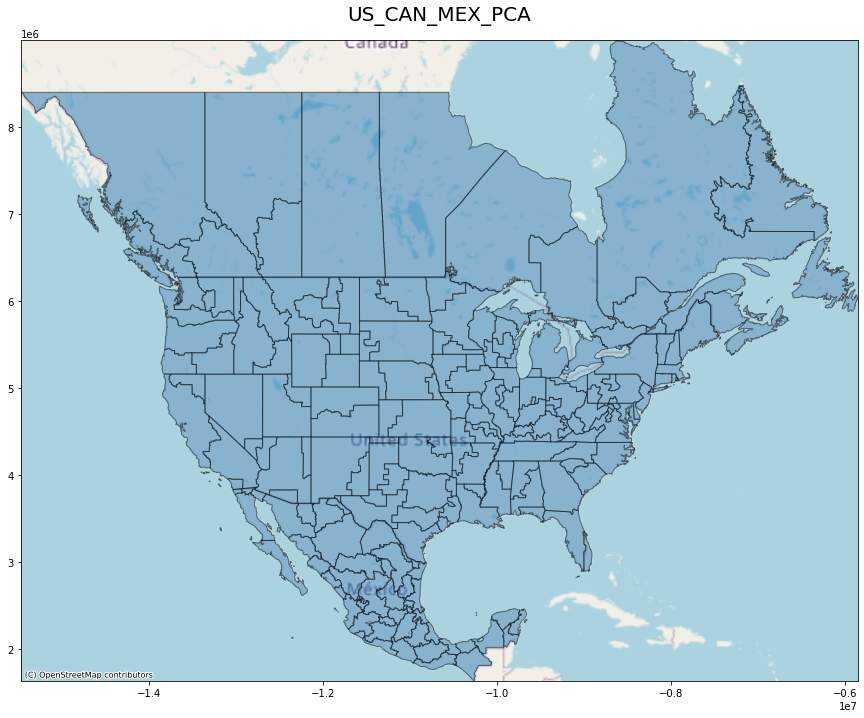

In [29]:
import pandas as pd
import geopandas as gpd
from shapely import wkt
import matplotlib.pyplot as plt
import contextily as ctx

# Path to the CSV file
csv_file_path = '/Users/ansonkong/Downloads/ReEDS-2.0-main/inputs/shapefiles/US_CAN_MEX_PCA_polygons.csv'

# Read the CSV file
df = pd.read_csv(csv_file_path)

# Assuming 'WKT' is the column with the geometries and 'rb' is a label
# Convert the 'WKT' column to geometries
gdf = gpd.GeoDataFrame(df, geometry=df['WKT'].apply(wkt.loads))

# Set the initial CRS to WGS84, then convert to Web Mercator for contextily
gdf.crs = "EPSG:4326"
gdf = gdf.to_crs(epsg=3857)

# Plotting
fig, ax = plt.subplots(figsize=(15, 15))  # Adjust figure size as needed
gdf.plot(ax=ax, alpha=0.5, edgecolor='k')  # Plot GeoDataFrame

# Add basemap
ctx.add_basemap(ax, source=ctx.providers.OpenStreetMap.Mapnik)  # You can choose different providers

# Optional: Adjust the map extent to your data's extent
ax.set_xlim([gdf.total_bounds[0], gdf.total_bounds[2]])
ax.set_ylim([gdf.total_bounds[1], gdf.total_bounds[3]])
ax.set_title("US_CAN_MEX_PCA", fontsize=20, pad=20) 
plt.show()






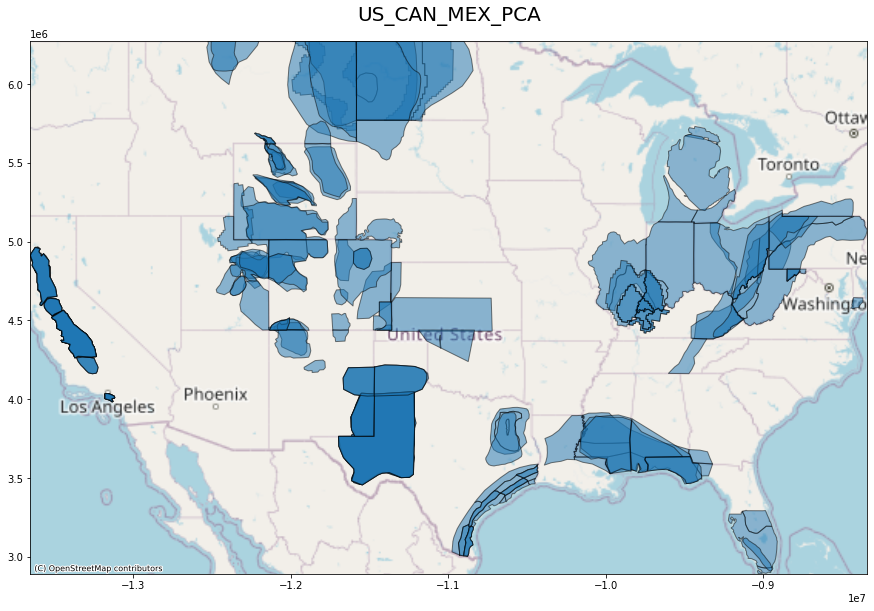

In [30]:
import pandas as pd
import geopandas as gpd
from shapely import wkt
import matplotlib.pyplot as plt
import contextily as ctx

# Path to the CSV file
csv_file_path = '/Users/ansonkong/Downloads/ReEDS-2.0-main/inputs/shapefiles/ctus_cs_polygons_BVRE.csv'

# Read the CSV file
df = pd.read_csv(csv_file_path)

# Assuming 'WKT' is the column with the geometries and 'rb' is a label
# Convert the 'WKT' column to geometries
gdf = gpd.GeoDataFrame(df, geometry=df['Formation Polygon Geometry'].apply(wkt.loads))

# Set the initial CRS to WGS84, then convert to Web Mercator for contextily
gdf.crs = "EPSG:4326"
gdf = gdf.to_crs(epsg=3857)

# Plotting
fig, ax = plt.subplots(figsize=(15, 15))  # Adjust figure size as needed
gdf.plot(ax=ax, alpha=0.5, edgecolor='k')  # Plot GeoDataFrame

# Add basemap
ctx.add_basemap(ax, source=ctx.providers.OpenStreetMap.Mapnik)  # You can choose different providers

# Optional: Adjust the map extent to your data's extent
ax.set_xlim([gdf.total_bounds[0], gdf.total_bounds[2]])
ax.set_ylim([gdf.total_bounds[1], gdf.total_bounds[3]])
ax.set_title("ctus_cs_polygons_BVRE", fontsize=20, pad=20) 
plt.show()

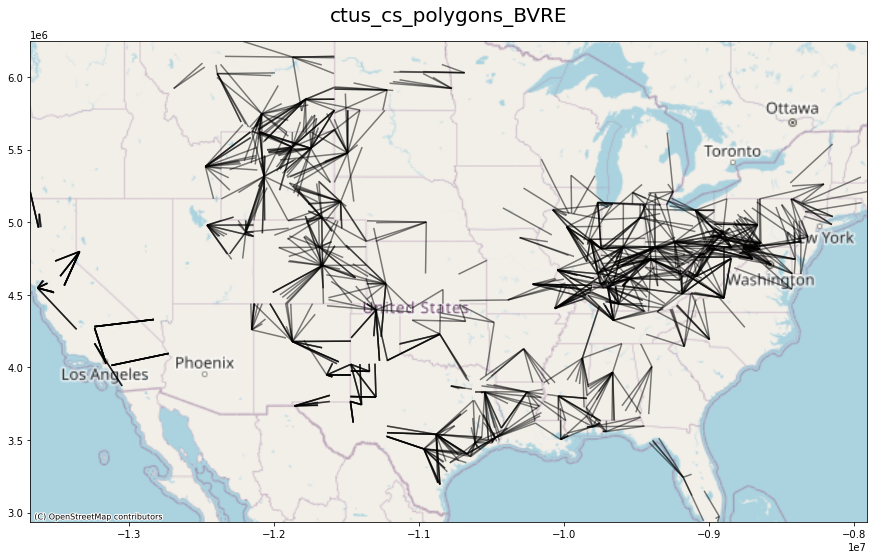

In [32]:
import pandas as pd
import geopandas as gpd
from shapely import wkt
import matplotlib.pyplot as plt
import contextily as ctx

# Path to the CSV file
csv_file_path = '/Users/ansonkong/Downloads/ReEDS-2.0-main/inputs/shapefiles/ctus_r_cs_spurlines_200mi.csv'

# Read the CSV file
df = pd.read_csv(csv_file_path)

# Assuming 'WKT' is the column with the geometries and 'rb' is a label
# Convert the 'WKT' column to geometries
gdf = gpd.GeoDataFrame(df, geometry=df['WKT'].apply(wkt.loads))

# Set the initial CRS to WGS84, then convert to Web Mercator for contextily
gdf.crs = "EPSG:4326"
gdf = gdf.to_crs(epsg=3857)

# Plotting
fig, ax = plt.subplots(figsize=(15, 15))  # Adjust figure size as needed
gdf.plot(ax=ax, alpha=0.5, edgecolor='k')  # Plot GeoDataFrame

# Add basemap
ctx.add_basemap(ax, source=ctx.providers.OpenStreetMap.Mapnik)  # You can choose different providers

# Optional: Adjust the map extent to your data's extent
ax.set_xlim([gdf.total_bounds[0], gdf.total_bounds[2]])
ax.set_ylim([gdf.total_bounds[1], gdf.total_bounds[3]])
ax.set_title("ctus_cs_polygons_BVRE", fontsize=20, pad=20) 
plt.show()

/var/folders/8v/68yqll_54lzgb57b5q8_fbrc0000gn/T/ipykernel_19106/3609196444.py:4: DeprecationWarning: WKTReadingError is deprecated and will be removed in a future version. Use ShapelyError instead (functions previously raising {name} will now raise a ShapelyError instead).
  from shapely.errors import WKTReadingError


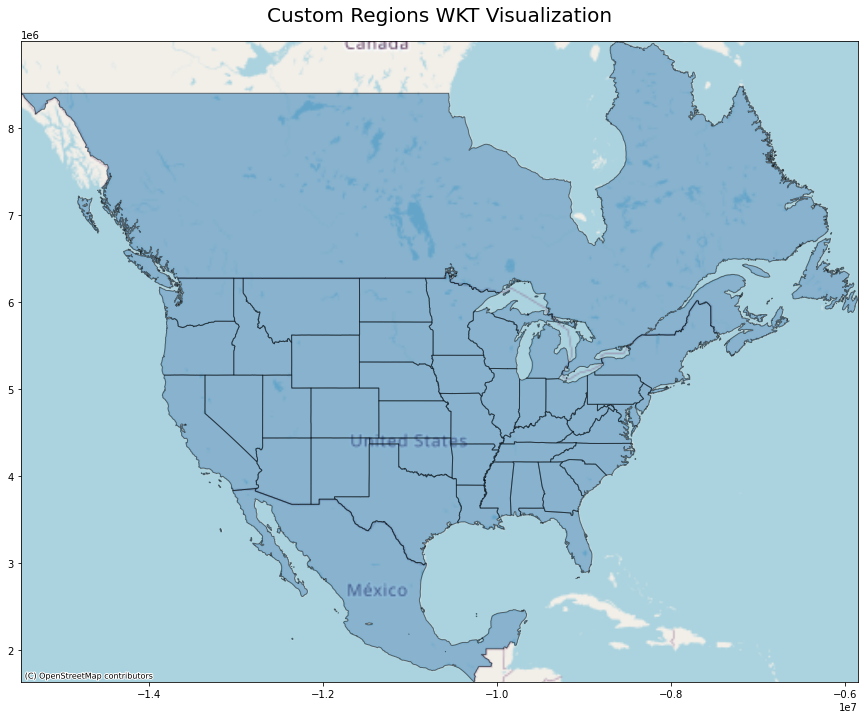

In [33]:
import pandas as pd
import geopandas as gpd
from shapely import wkt
from shapely.errors import WKTReadingError
import matplotlib.pyplot as plt
import contextily as ctx

# Function to safely load WKT geometries
def safe_loads_wkt(wkt_string):
    try:
        return wkt.loads(wkt_string)
    except WKTReadingError:
        return None

# Path to the CSV file
csv_file_path = '/Users/ansonkong/Downloads/ReEDS-2.0-main/inputs/shapefiles/WKT_csvs/customreg_WKT.csv'

# Read the CSV file
df = pd.read_csv(csv_file_path)

# Apply the safe_loads_wkt function and filter out None values
df['geometry'] = df['WKT'].apply(safe_loads_wkt)
df = df.dropna(subset=['geometry'])

# Convert the DataFrame to a GeoDataFrame
gdf = gpd.GeoDataFrame(df, geometry='geometry')

# Set the initial CRS to WGS84, then convert to Web Mercator for contextily
gdf.crs = "EPSG:4326"
gdf = gdf.to_crs(epsg=3857)

# Plotting
fig, ax = plt.subplots(figsize=(15, 15))  # Adjust figure size as needed
gdf.plot(ax=ax, alpha=0.5, edgecolor='k')  # Plot GeoDataFrame

# Add basemap
ctx.add_basemap(ax, source=ctx.providers.OpenStreetMap.Mapnik)  # You can choose different providers

# Optional: Adjust the map extent to your data's extent
ax.set_xlim([gdf.total_bounds[0], gdf.total_bounds[2]])
ax.set_ylim([gdf.total_bounds[1], gdf.total_bounds[3]])

# Add a title
ax.set_title("Custom Regions WKT Visualization", fontsize=20, pad=20)

plt.show()


/var/folders/8v/68yqll_54lzgb57b5q8_fbrc0000gn/T/ipykernel_19106/2255000723.py:4: DeprecationWarning: WKTReadingError is deprecated and will be removed in a future version. Use ShapelyError instead (functions previously raising {name} will now raise a ShapelyError instead).
  from shapely.errors import WKTReadingError


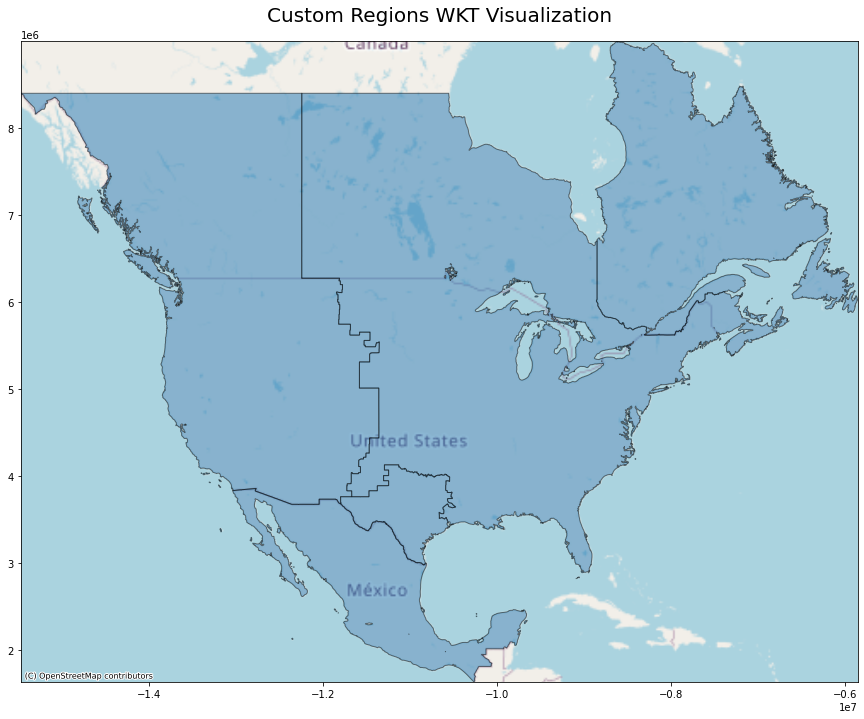

In [34]:
import pandas as pd
import geopandas as gpd
from shapely import wkt
from shapely.errors import WKTReadingError
import matplotlib.pyplot as plt
import contextily as ctx

# Function to safely load WKT geometries
def safe_loads_wkt(wkt_string):
    try:
        return wkt.loads(wkt_string)
    except WKTReadingError:
        return None

# Path to the CSV file
csv_file_path = '/Users/ansonkong/Downloads/ReEDS-2.0-main/inputs/shapefiles/WKT_csvs/interconnect_WKT.csv'

# Read the CSV file
df = pd.read_csv(csv_file_path)

# Apply the safe_loads_wkt function and filter out None values
df['geometry'] = df['WKT'].apply(safe_loads_wkt)
df = df.dropna(subset=['geometry'])

# Convert the DataFrame to a GeoDataFrame
gdf = gpd.GeoDataFrame(df, geometry='geometry')

# Set the initial CRS to WGS84, then convert to Web Mercator for contextily
gdf.crs = "EPSG:4326"
gdf = gdf.to_crs(epsg=3857)

# Plotting
fig, ax = plt.subplots(figsize=(15, 15))  # Adjust figure size as needed
gdf.plot(ax=ax, alpha=0.5, edgecolor='k')  # Plot GeoDataFrame

# Add basemap
ctx.add_basemap(ax, source=ctx.providers.OpenStreetMap.Mapnik)  # You can choose different providers

# Optional: Adjust the map extent to your data's extent
ax.set_xlim([gdf.total_bounds[0], gdf.total_bounds[2]])
ax.set_ylim([gdf.total_bounds[1], gdf.total_bounds[3]])

# Add a title
ax.set_title("Custom Regions WKT Visualization", fontsize=20, pad=20)

plt.show()


/var/folders/8v/68yqll_54lzgb57b5q8_fbrc0000gn/T/ipykernel_19106/1440768414.py:4: DeprecationWarning: WKTReadingError is deprecated and will be removed in a future version. Use ShapelyError instead (functions previously raising {name} will now raise a ShapelyError instead).
  from shapely.errors import WKTReadingError


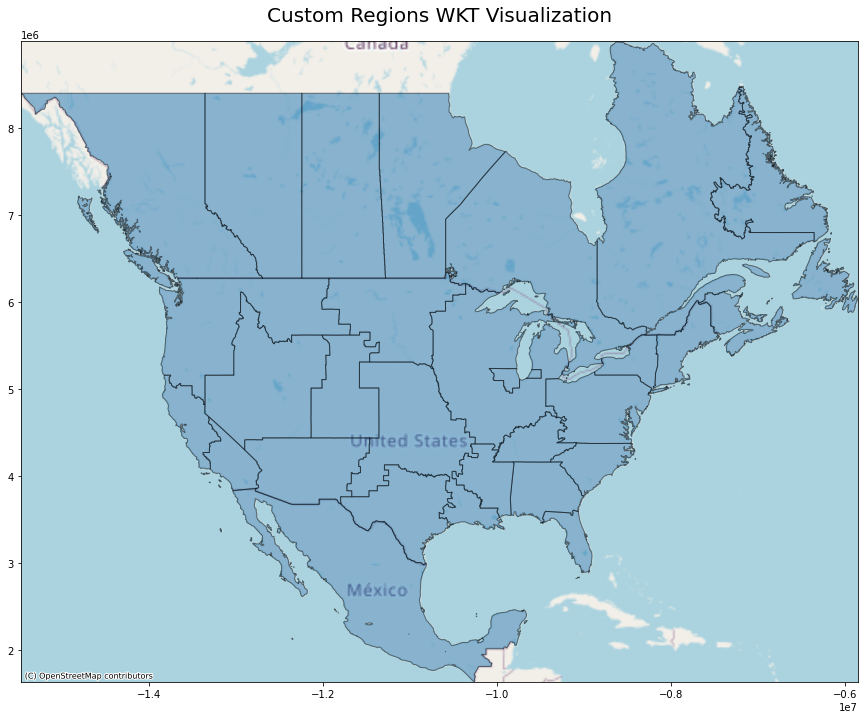

In [35]:
import pandas as pd
import geopandas as gpd
from shapely import wkt
from shapely.errors import WKTReadingError
import matplotlib.pyplot as plt
import contextily as ctx

# Function to safely load WKT geometries
def safe_loads_wkt(wkt_string):
    try:
        return wkt.loads(wkt_string)
    except WKTReadingError:
        return None

# Path to the CSV file
csv_file_path = '/Users/ansonkong/Downloads/ReEDS-2.0-main/inputs/shapefiles/WKT_csvs/nerc_new_WKT.csv'

# Read the CSV file
df = pd.read_csv(csv_file_path)

# Apply the safe_loads_wkt function and filter out None values
df['geometry'] = df['WKT'].apply(safe_loads_wkt)
df = df.dropna(subset=['geometry'])

# Convert the DataFrame to a GeoDataFrame
gdf = gpd.GeoDataFrame(df, geometry='geometry')

# Set the initial CRS to WGS84, then convert to Web Mercator for contextily
gdf.crs = "EPSG:4326"
gdf = gdf.to_crs(epsg=3857)

# Plotting
fig, ax = plt.subplots(figsize=(15, 15))  # Adjust figure size as needed
gdf.plot(ax=ax, alpha=0.5, edgecolor='k')  # Plot GeoDataFrame

# Add basemap
ctx.add_basemap(ax, source=ctx.providers.OpenStreetMap.Mapnik)  # You can choose different providers

# Optional: Adjust the map extent to your data's extent
ax.set_xlim([gdf.total_bounds[0], gdf.total_bounds[2]])
ax.set_ylim([gdf.total_bounds[1], gdf.total_bounds[3]])

# Add a title
ax.set_title("Custom Regions WKT Visualization", fontsize=20, pad=20)

plt.show()


/var/folders/8v/68yqll_54lzgb57b5q8_fbrc0000gn/T/ipykernel_19106/2456666274.py:4: DeprecationWarning: WKTReadingError is deprecated and will be removed in a future version. Use ShapelyError instead (functions previously raising {name} will now raise a ShapelyError instead).
  from shapely.errors import WKTReadingError


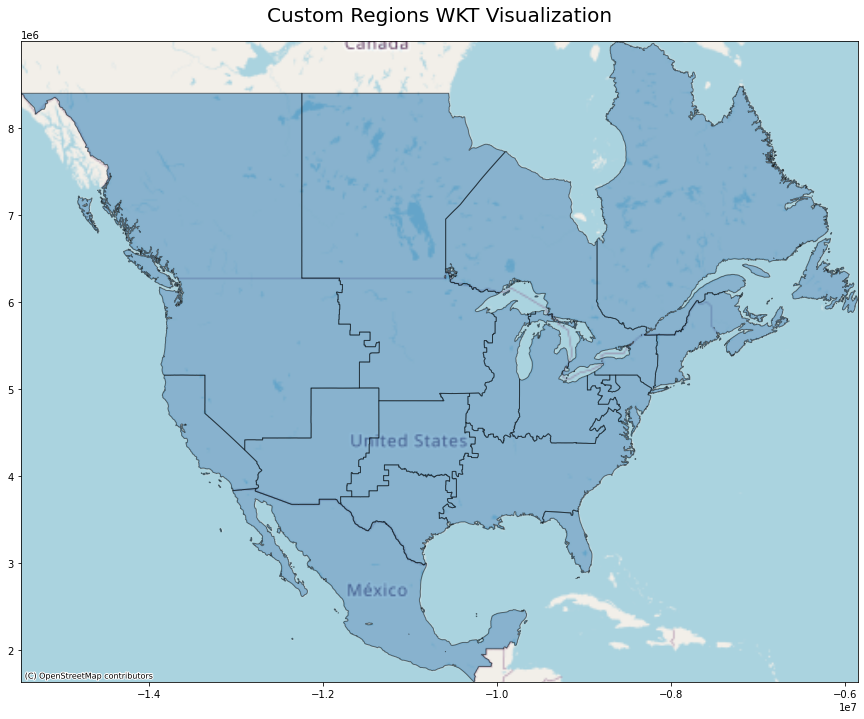

In [36]:

import pandas as pd
import geopandas as gpd
from shapely import wkt
from shapely.errors import WKTReadingError
import matplotlib.pyplot as plt
import contextily as ctx

# Function to safely load WKT geometries
def safe_loads_wkt(wkt_string):
    try:
        return wkt.loads(wkt_string)
    except WKTReadingError:
        return None

# Path to the CSV file
csv_file_path = '/Users/ansonkong/Downloads/ReEDS-2.0-main/inputs/shapefiles/WKT_csvs/nerc_WKT.csv'

# Read the CSV file
df = pd.read_csv(csv_file_path)

# Apply the safe_loads_wkt function and filter out None values
df['geometry'] = df['WKT'].apply(safe_loads_wkt)
df = df.dropna(subset=['geometry'])

# Convert the DataFrame to a GeoDataFrame
gdf = gpd.GeoDataFrame(df, geometry='geometry')

# Set the initial CRS to WGS84, then convert to Web Mercator for contextily
gdf.crs = "EPSG:4326"
gdf = gdf.to_crs(epsg=3857)

# Plotting
fig, ax = plt.subplots(figsize=(15, 15))  # Adjust figure size as needed
gdf.plot(ax=ax, alpha=0.5, edgecolor='k')  # Plot GeoDataFrame

# Add basemap
ctx.add_basemap(ax, source=ctx.providers.OpenStreetMap.Mapnik)  # You can choose different providers

# Optional: Adjust the map extent to your data's extent
ax.set_xlim([gdf.total_bounds[0], gdf.total_bounds[2]])
ax.set_ylim([gdf.total_bounds[1], gdf.total_bounds[3]])

# Add a title
ax.set_title("Custom Regions WKT Visualization", fontsize=20, pad=20)

plt.show()

/var/folders/8v/68yqll_54lzgb57b5q8_fbrc0000gn/T/ipykernel_19106/2455213777.py:4: DeprecationWarning: WKTReadingError is deprecated and will be removed in a future version. Use ShapelyError instead (functions previously raising {name} will now raise a ShapelyError instead).
  from shapely.errors import WKTReadingError


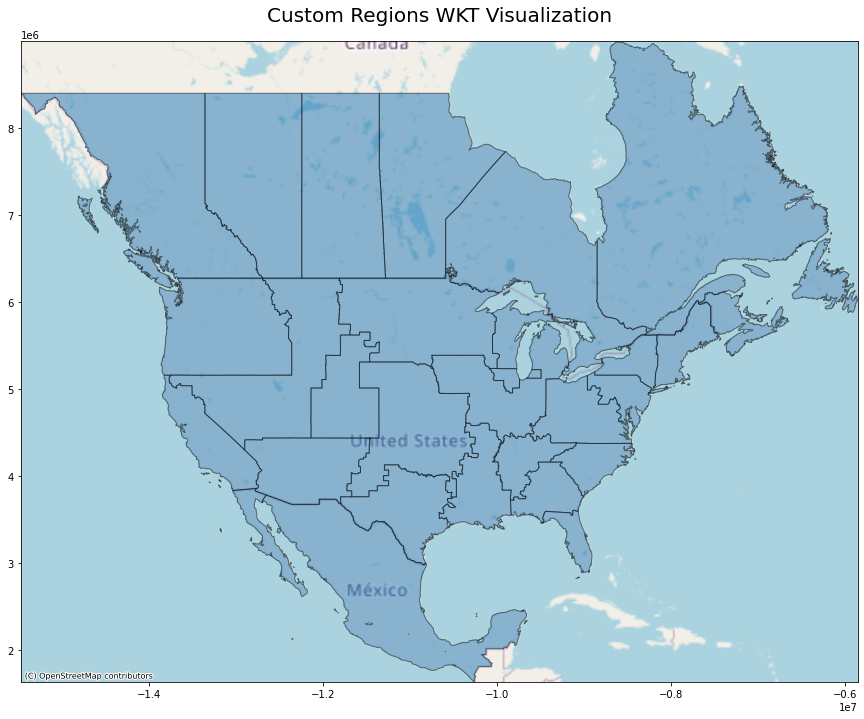

In [37]:

import pandas as pd
import geopandas as gpd
from shapely import wkt
from shapely.errors import WKTReadingError
import matplotlib.pyplot as plt
import contextily as ctx

# Function to safely load WKT geometries
def safe_loads_wkt(wkt_string):
    try:
        return wkt.loads(wkt_string)
    except WKTReadingError:
        return None

# Path to the CSV file
csv_file_path = '/Users/ansonkong/Downloads/ReEDS-2.0-main/inputs/shapefiles/WKT_csvs/rto_WKT.csv'

# Read the CSV file
df = pd.read_csv(csv_file_path)

# Apply the safe_loads_wkt function and filter out None values
df['geometry'] = df['WKT'].apply(safe_loads_wkt)
df = df.dropna(subset=['geometry'])

# Convert the DataFrame to a GeoDataFrame
gdf = gpd.GeoDataFrame(df, geometry='geometry')

# Set the initial CRS to WGS84, then convert to Web Mercator for contextily
gdf.crs = "EPSG:4326"
gdf = gdf.to_crs(epsg=3857)

# Plotting
fig, ax = plt.subplots(figsize=(15, 15))  # Adjust figure size as needed
gdf.plot(ax=ax, alpha=0.5, edgecolor='k')  # Plot GeoDataFrame

# Add basemap
ctx.add_basemap(ax, source=ctx.providers.OpenStreetMap.Mapnik)  # You can choose different providers

# Optional: Adjust the map extent to your data's extent
ax.set_xlim([gdf.total_bounds[0], gdf.total_bounds[2]])
ax.set_ylim([gdf.total_bounds[1], gdf.total_bounds[3]])

# Add a title
ax.set_title("Custom Regions WKT Visualization", fontsize=20, pad=20)

plt.show()

/var/folders/8v/68yqll_54lzgb57b5q8_fbrc0000gn/T/ipykernel_19106/1902634592.py:4: DeprecationWarning: WKTReadingError is deprecated and will be removed in a future version. Use ShapelyError instead (functions previously raising {name} will now raise a ShapelyError instead).
  from shapely.errors import WKTReadingError


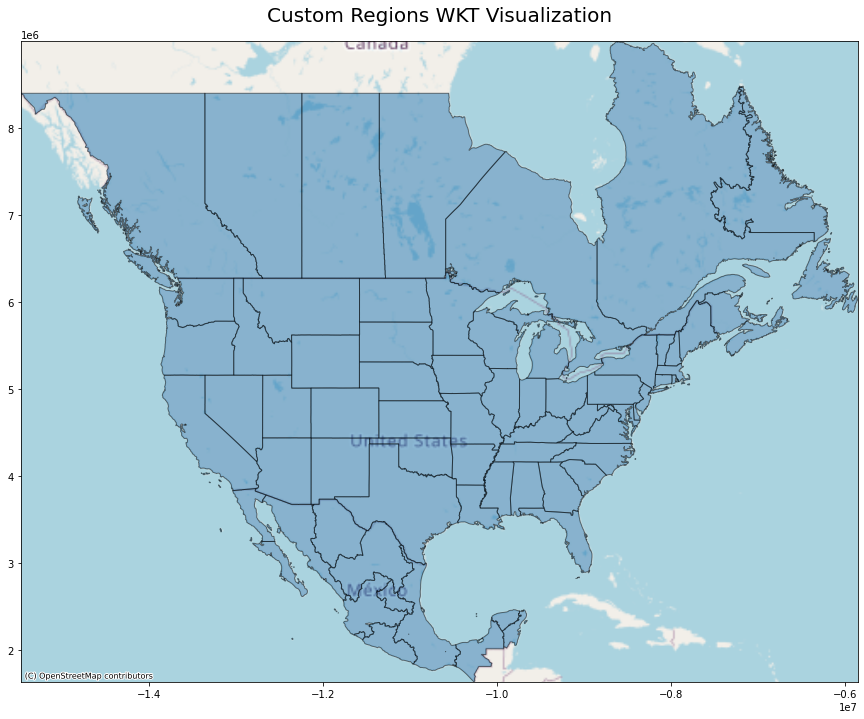

In [38]:

import pandas as pd
import geopandas as gpd
from shapely import wkt
from shapely.errors import WKTReadingError
import matplotlib.pyplot as plt
import contextily as ctx

# Function to safely load WKT geometries
def safe_loads_wkt(wkt_string):
    try:
        return wkt.loads(wkt_string)
    except WKTReadingError:
        return None

# Path to the CSV file
csv_file_path = '/Users/ansonkong/Downloads/ReEDS-2.0-main/inputs/shapefiles/WKT_csvs/st_WKT.csv'

# Read the CSV file
df = pd.read_csv(csv_file_path)

# Apply the safe_loads_wkt function and filter out None values
df['geometry'] = df['WKT'].apply(safe_loads_wkt)
df = df.dropna(subset=['geometry'])

# Convert the DataFrame to a GeoDataFrame
gdf = gpd.GeoDataFrame(df, geometry='geometry')

# Set the initial CRS to WGS84, then convert to Web Mercator for contextily
gdf.crs = "EPSG:4326"
gdf = gdf.to_crs(epsg=3857)

# Plotting
fig, ax = plt.subplots(figsize=(15, 15))  # Adjust figure size as needed
gdf.plot(ax=ax, alpha=0.5, edgecolor='k')  # Plot GeoDataFrame

# Add basemap
ctx.add_basemap(ax, source=ctx.providers.OpenStreetMap.Mapnik)  # You can choose different providers

# Optional: Adjust the map extent to your data's extent
ax.set_xlim([gdf.total_bounds[0], gdf.total_bounds[2]])
ax.set_ylim([gdf.total_bounds[1], gdf.total_bounds[3]])

# Add a title
ax.set_title("Custom Regions WKT Visualization", fontsize=20, pad=20)

plt.show()

/var/folders/8v/68yqll_54lzgb57b5q8_fbrc0000gn/T/ipykernel_19106/1162221543.py:4: DeprecationWarning: WKTReadingError is deprecated and will be removed in a future version. Use ShapelyError instead (functions previously raising {name} will now raise a ShapelyError instead).
  from shapely.errors import WKTReadingError


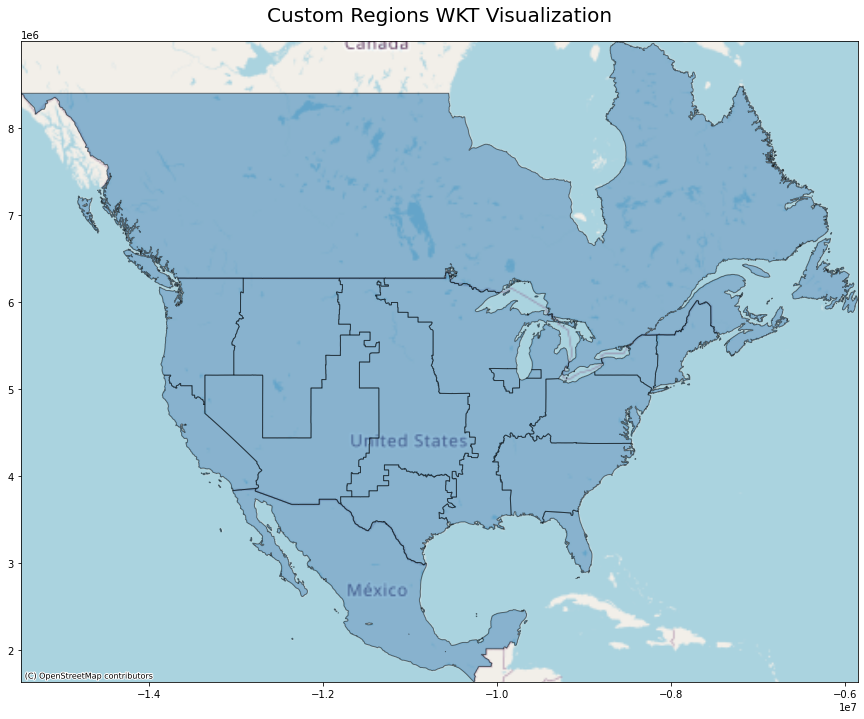

In [39]:

import pandas as pd
import geopandas as gpd
from shapely import wkt
from shapely.errors import WKTReadingError
import matplotlib.pyplot as plt
import contextily as ctx

# Function to safely load WKT geometries
def safe_loads_wkt(wkt_string):
    try:
        return wkt.loads(wkt_string)
    except WKTReadingError:
        return None

# Path to the CSV file
csv_file_path = '/Users/ansonkong/Downloads/ReEDS-2.0-main/inputs/shapefiles/WKT_csvs/transreg_WKT.csv'

# Read the CSV file
df = pd.read_csv(csv_file_path)

# Apply the safe_loads_wkt function and filter out None values
df['geometry'] = df['WKT'].apply(safe_loads_wkt)
df = df.dropna(subset=['geometry'])

# Convert the DataFrame to a GeoDataFrame
gdf = gpd.GeoDataFrame(df, geometry='geometry')

# Set the initial CRS to WGS84, then convert to Web Mercator for contextily
gdf.crs = "EPSG:4326"
gdf = gdf.to_crs(epsg=3857)

# Plotting
fig, ax = plt.subplots(figsize=(15, 15))  # Adjust figure size as needed
gdf.plot(ax=ax, alpha=0.5, edgecolor='k')  # Plot GeoDataFrame

# Add basemap
ctx.add_basemap(ax, source=ctx.providers.OpenStreetMap.Mapnik)  # You can choose different providers

# Optional: Adjust the map extent to your data's extent
ax.set_xlim([gdf.total_bounds[0], gdf.total_bounds[2]])
ax.set_ylim([gdf.total_bounds[1], gdf.total_bounds[3]])

# Add a title
ax.set_title("Custom Regions WKT Visualization", fontsize=20, pad=20)

plt.show()

/var/folders/8v/68yqll_54lzgb57b5q8_fbrc0000gn/T/ipykernel_19106/2716434106.py:4: DeprecationWarning: WKTReadingError is deprecated and will be removed in a future version. Use ShapelyError instead (functions previously raising {name} will now raise a ShapelyError instead).
  from shapely.errors import WKTReadingError


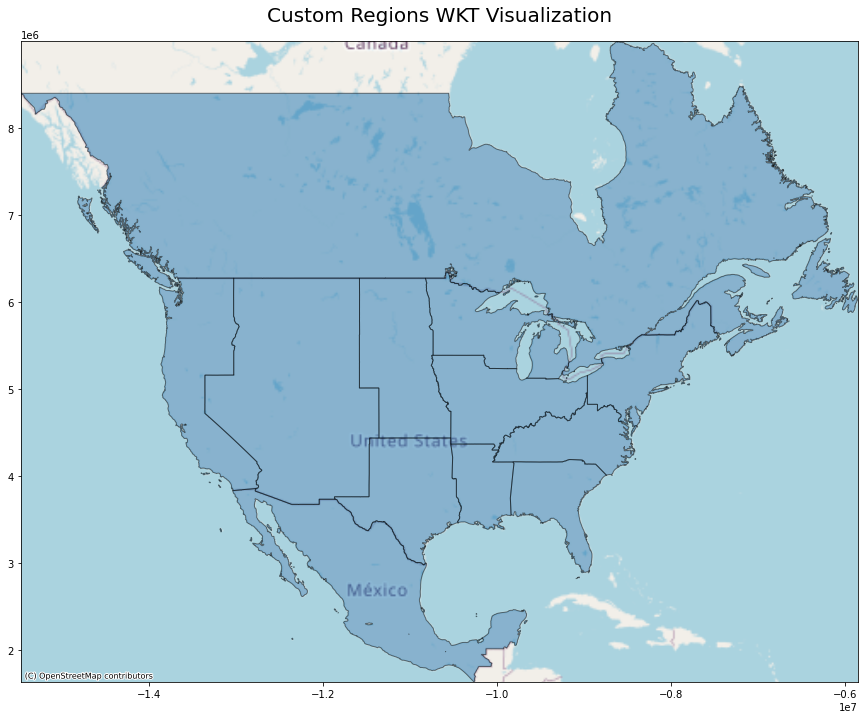

In [40]:

import pandas as pd
import geopandas as gpd
from shapely import wkt
from shapely.errors import WKTReadingError
import matplotlib.pyplot as plt
import contextily as ctx

# Function to safely load WKT geometries
def safe_loads_wkt(wkt_string):
    try:
        return wkt.loads(wkt_string)
    except WKTReadingError:
        return None

# Path to the CSV file
csv_file_path = '/Users/ansonkong/Downloads/ReEDS-2.0-main/inputs/shapefiles/WKT_csvs/usda_WKT.csv'

# Read the CSV file
df = pd.read_csv(csv_file_path)

# Apply the safe_loads_wkt function and filter out None values
df['geometry'] = df['WKT'].apply(safe_loads_wkt)
df = df.dropna(subset=['geometry'])

# Convert the DataFrame to a GeoDataFrame
gdf = gpd.GeoDataFrame(df, geometry='geometry')

# Set the initial CRS to WGS84, then convert to Web Mercator for contextily
gdf.crs = "EPSG:4326"
gdf = gdf.to_crs(epsg=3857)

# Plotting
fig, ax = plt.subplots(figsize=(15, 15))  # Adjust figure size as needed
gdf.plot(ax=ax, alpha=0.5, edgecolor='k')  # Plot GeoDataFrame

# Add basemap
ctx.add_basemap(ax, source=ctx.providers.OpenStreetMap.Mapnik)  # You can choose different providers

# Optional: Adjust the map extent to your data's extent
ax.set_xlim([gdf.total_bounds[0], gdf.total_bounds[2]])
ax.set_ylim([gdf.total_bounds[1], gdf.total_bounds[3]])

# Add a title
ax.set_title("Custom Regions WKT Visualization", fontsize=20, pad=20)

plt.show()

NameError: name 'gdfs' is not defined

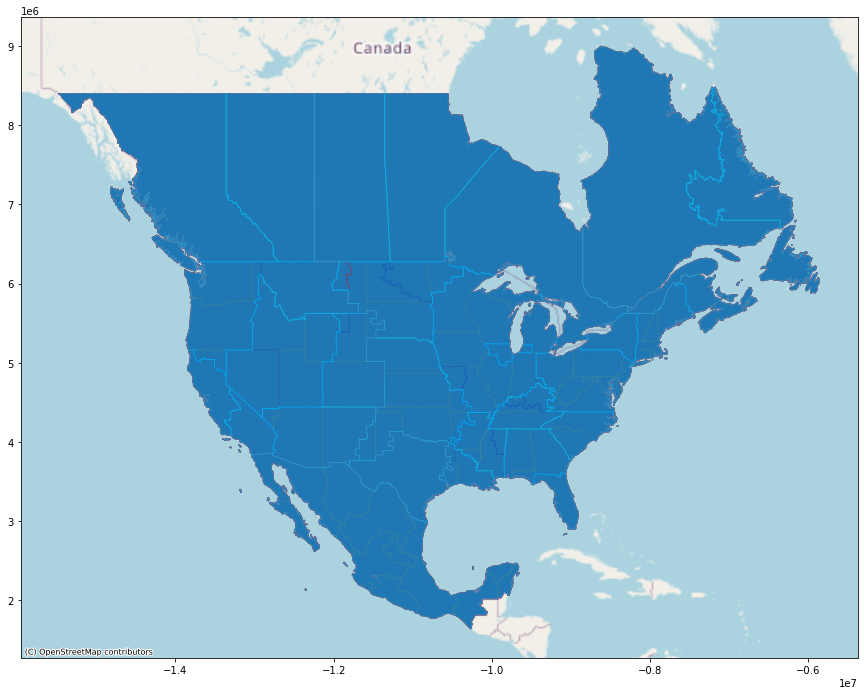

In [42]:
import pandas as pd
import geopandas as gpd
from shapely import wkt
import matplotlib.pyplot as plt
import contextily as ctx
import glob
import os
import numpy as np

# Function to safely load WKT geometries
def safe_loads_wkt(wkt_string):
    try:
        return wkt.loads(wkt_string)
    except WKTReadingError:
        return None

# Path to the directory containing the CSV files
csv_directory_path = '/Users/ansonkong/Downloads/ReEDS-2.0-main/inputs/shapefiles/WKT_csvs'

# List of all CSV files
csv_files = glob.glob(os.path.join(csv_directory_path, '*.csv'))

# Initialize a figure and axis for plotting
fig, ax = plt.subplots(figsize=(15, 15))

# Loop through the CSV files and plot each one
for csv_file in csv_files:
    # Read the CSV file
    df = pd.read_csv(csv_file)

    # Apply the safe_loads_wkt function and filter out None values
    df['geometry'] = df['WKT'].apply(safe_loads_wkt)
    df = df.dropna(subset=['geometry'])

    # Convert the DataFrame to a GeoDataFrame
    gdf = gpd.GeoDataFrame(df, geometry='geometry')

    # Set the initial CRS to WGS84, then convert to Web Mercator for contextily
    gdf.crs = "EPSG:4326"
    gdf = gdf.to_crs(epsg=3857)

    # Generate a random color for the plot
    color = plt.cm.jet(np.random.rand())

    # Plot GeoDataFrame with a unique color
    gdf.plot(ax=ax, edgecolor=color, alpha=0.5, linewidth=1)

# Add basemap
ctx.add_basemap(ax, source=ctx.providers.OpenStreetMap.Mapnik)

# Optional: Adjust the map extent to the combined extent of all layers
all_bounds = [gdf.total_bounds for gdf in gdfs]
combined_bounds = np.vstack(all_bounds)
xlim = (combined_bounds[:,0].min(), combined_bounds[:,2].max())
ylim = (combined_bounds[:,1].min(), combined_bounds[:,3].max())
ax.set_xlim(xlim)
ax.set_ylim(ylim)

# Add a title
ax.set_title("Combined CSV Geometries", fontsize=20, pad=20)

# Show the plot
plt.show()


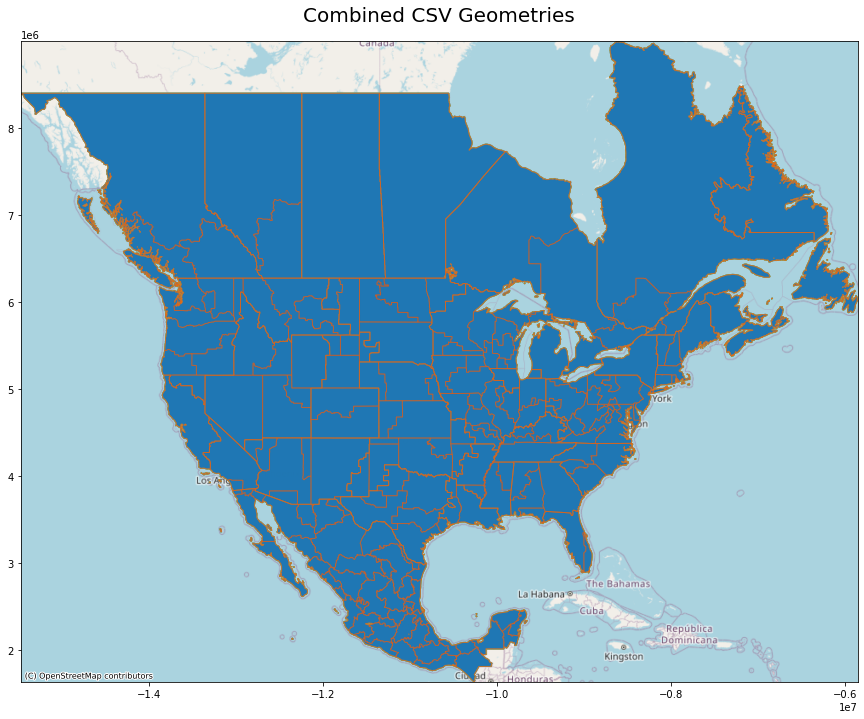

In [43]:
import pandas as pd
import geopandas as gpd
import matplotlib.pyplot as plt
import contextily as ctx
import numpy as np
import os
import glob

# Function to load and convert CSV data to GeoDataFrame
def load_and_convert(csv_file_path):
    df = pd.read_csv(csv_file_path)
    df['geometry'] = df['WKT'].apply(safe_loads_wkt)
    df = df.dropna(subset=['geometry'])
    gdf = gpd.GeoDataFrame(df, geometry='geometry')
    gdf.crs = "EPSG:4326"
    gdf = gdf.to_crs(epsg=3857)
    return gdf

# Function to safely load WKT geometries
def safe_loads_wkt(wkt_string):
    try:
        return wkt.loads(wkt_string)
    except Exception as e:  # Catch all exceptions related to WKT parsing
        print(f"Error parsing WKT: {e}")
        return None

# Path to the directory containing CSV files
directory_path = '/Users/ansonkong/Downloads/ReEDS-2.0-main/inputs/shapefiles/WKT_csvs'
# Paths to the individual CSV files
individual_file_paths = [
    '/Users/ansonkong/Downloads/ReEDS-2.0-main/inputs/shapefiles/US_CAN_MEX_PCA_polygons.csv'
   ]

# Initialize a figure and axis for plotting
fig, ax = plt.subplots(figsize=(15, 15))

# Variable to hold the total bounds of all geometries
combined_bounds = []

# Load and plot CSV files from the directory
for csv_file in glob.glob(os.path.join(directory_path, '*.csv')):
    gdf = load_and_convert(csv_file)
    color = plt.cm.jet(np.random.rand())  # Random color for each file
    gdf.plot(ax=ax, edgecolor=color, alpha=0.5, linewidth=1)
    combined_bounds.append(gdf.total_bounds)

# Load and plot individual CSV files
for csv_file in individual_file_paths:
    gdf = load_and_convert(csv_file)
    color = plt.cm.jet(np.random.rand())  # Random color for each file
    gdf.plot(ax=ax, edgecolor=color, alpha=0.5, linewidth=1)
    combined_bounds.append(gdf.total_bounds)

# Calculate the overall bounds
combined_bounds = np.vstack(combined_bounds)
xlim = (combined_bounds[:,0].min(), combined_bounds[:,2].max())
ylim = (combined_bounds[:,1].min(), combined_bounds[:,3].max())

# Adjust the map extent to the combined bounds
ax.set_xlim(xlim)
ax.set_ylim(ylim)

# Add basemap
ctx.add_basemap(ax, source=ctx.providers.OpenStreetMap.Mapnik)

# Add a title
ax.set_title("Combined CSV Geometries", fontsize=20, pad=20)

# Show the plot
plt.show()


In [44]:
from shapely import wkt
import pandas as pd
import geopandas as gpd
import matplotlib.pyplot as plt
import contextily as ctx
import numpy as np
import os
import glob

# Ensure the wkt module is correctly referenced
from shapely import wkt

# Function to load and convert CSV data to GeoDataFrame
def load_and_convert(csv_file_path):
    df = pd.read_csv(csv_file_path)
    df['geometry'] = df['WKT'].apply(safe_loads_wkt)
    df = df.dropna(subset=['geometry'])
    gdf = gpd.GeoDataFrame(df, geometry='geometry')
    gdf.crs = "EPSG:4326"
    gdf = gdf.to_crs(epsg=3857)
    return gdf

# Function to safely load WKT geometries
def safe_loads_wkt(wkt_string):
    try:
        return wkt.loads(wkt_string)
    except Exception as e:  # Catch all exceptions related to WKT parsing
        print(f"Error parsing WKT: {e}")
        return None

# Initialize an empty list to hold all GeoDataFrames
all_gdfs = []

# Load CSV files from the directory and individual file paths, then add to the list
directory_path = '/Users/ansonkong/Downloads/ReEDS-2.0-main/inputs/shapefiles/WKT_csvs'
individual_file_paths = [
    '/Users/ansonkong/Downloads/ReEDS-2.0-main/inputs/shapefiles/US_CAN_MEX_PCA_polygons.csv'
]

for csv_file in glob.glob(os.path.join(directory_path, '*.csv')) + individual_file_paths:
    gdf = load_and_convert(csv_file)
    all_gdfs.append(gdf)

# Combine all GeoDataFrames into a single GeoDataFrame
combined_gdf = pd.concat(all_gdfs, ignore_index=True)

# Save the combined GeoDataFrame as a Shapefile
output_shapefile_path = '/Users/ansonkong/Downloads/merradownload-master/shapefile/subregion/combined_geometries.shp'
combined_gdf.to_file(output_shapefile_path)

# Convert the 'geometry' column to WKT for CSV output
combined_gdf['WKT'] = combined_gdf['geometry'].apply(lambda x: x.wkt)

# Drop the 'geometry' column for the CSV since it's now represented as WKT
combined_gdf_csv = combined_gdf.drop('geometry', axis=1)

# Save the combined GeoDataFrame as a CSV
output_csv_path = '/Users/ansonkong/Downloads/merradownload-master/shapefile/combined_geometries.csv'
combined_gdf_csv.to_csv(output_csv_path, index=False)


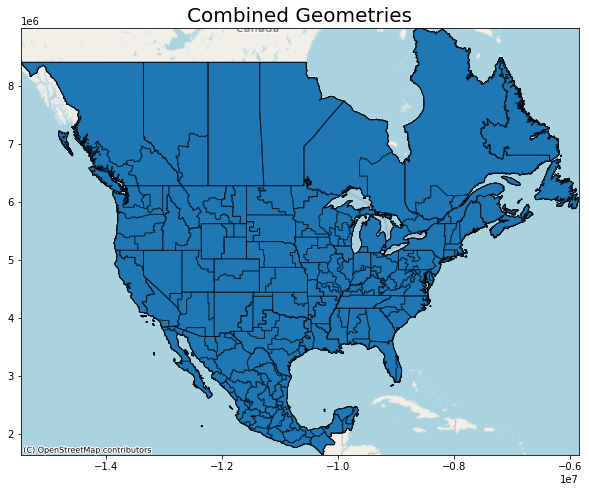

In [45]:
import geopandas as gpd
import matplotlib.pyplot as plt
import contextily as ctx

# Path to the combined shapefile
output_shapefile_path = '/Users/ansonkong/Downloads/merradownload-master/shapefile/subregion/combined_geometries.shp'

# Read the combined shapefile
combined_gdf = gpd.read_file(output_shapefile_path)

# Initialize a plot
fig, ax = plt.subplots(figsize=(10, 10))

# Plot the combined GeoDataFrame
combined_gdf.plot(ax=ax, alpha=0.5, edgecolor='k')

# Optionally, add a basemap
ctx.add_basemap(ax, source=ctx.providers.OpenStreetMap.Mapnik, crs=combined_gdf.crs)

# Adjust the plot's limits to fit the geometries
ax.set_xlim(combined_gdf.total_bounds[[0, 2]])
ax.set_ylim(combined_gdf.total_bounds[[1, 3]])

# Add titles and labels as needed
ax.set_title('Combined Geometries', fontsize=20)

plt.show()


In [54]:
import pandas as pd
import geopandas as gpd
import glob
from shapely import wkt

def load_csv_as_gdf(csv_file_path):
    print(csv_file_path)
    df = pd.read_csv(csv_file_path)
    print(df.columns)
    df['geometry'] = df['WKT'].apply(lambda x: wkt.loads(x))
    df = df.dropna(subset=['geometry'])
    gdf = gpd.GeoDataFrame(df, geometry='geometry')
    gdf.crs = "EPSG:4326"
    return gdf

# Load the base file
base_file_path = '/Users/ansonkong/Downloads/ReEDS-2.0-main/inputs/shapefiles/US_CAN_MEX_PCA_polygons.csv'
base_gdf = load_csv_as_gdf(base_file_path)

# Directory containing additional CSV files
directory_path = '/Users/ansonkong/Downloads/ReEDS-2.0-main/inputs/shapefiles/WKT_csvs/'

# Process each CSV file in the directory (excluding the base file)
for csv_file in glob.glob(f"{directory_path}*.csv"):
    if csv_file == base_file_path:
        continue  # Skip the base file
    
    # Load the additional file as a GeoDataFrame
    additional_gdf = load_csv_as_gdf(csv_file)
    
    # Perform a spatial join to find overlaps
    overlaps = gpd.sjoin(base_gdf, additional_gdf, how='left', op='intersects')


# After processing all files, base_gdf now includes additional information based on spatial overlaps
# Optionally, save the updated base GeoDataFrame as a new shapefile or CSV
output_shapefile_path = '/Users/ansonkong/Downloads/merradownload-master/shapefile/updated_base_geometries.shp'
base_gdf.to_file(output_shapefile_path)

output_csv_path = '/Users/ansonkong/Downloads/merradownload-master/shapefile/updated_base_geometries.csv'
base_gdf.drop('geometry', axis=1).to_csv(output_csv_path, index=False)


/Users/ansonkong/Downloads/ReEDS-2.0-main/inputs/shapefiles/US_CAN_MEX_PCA_polygons.csv
Index(['WKT', 'rb'], dtype='object')
/Users/ansonkong/Downloads/ReEDS-2.0-main/inputs/shapefiles/WKT_csvs/cendiv_WKT.csv
Index(['WKT', 'cendiv'], dtype='object')
/Users/ansonkong/Downloads/ReEDS-2.0-main/inputs/shapefiles/WKT_csvs/country_WKT.csv


/opt/anaconda3/lib/python3.9/site-packages/IPython/core/interactiveshell.py:3309: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  if await self.run_code(code, result, async_=asy):
/opt/anaconda3/lib/python3.9/site-packages/IPython/core/interactiveshell.py:3309: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  if await self.run_code(code, result, async_=asy):


Index(['WKT', 'country'], dtype='object')
/Users/ansonkong/Downloads/ReEDS-2.0-main/inputs/shapefiles/WKT_csvs/rto_WKT.csv
Index(['WKT', 'rto'], dtype='object')
/Users/ansonkong/Downloads/ReEDS-2.0-main/inputs/shapefiles/WKT_csvs/customreg_WKT.csv
Index(['WKT', 'customreg'], dtype='object')


/opt/anaconda3/lib/python3.9/site-packages/IPython/core/interactiveshell.py:3309: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  if await self.run_code(code, result, async_=asy):
/opt/anaconda3/lib/python3.9/site-packages/IPython/core/interactiveshell.py:3309: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  if await self.run_code(code, result, async_=asy):


/Users/ansonkong/Downloads/ReEDS-2.0-main/inputs/shapefiles/WKT_csvs/usda_WKT.csv
Index(['WKT', 'usda'], dtype='object')


/opt/anaconda3/lib/python3.9/site-packages/IPython/core/interactiveshell.py:3309: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  if await self.run_code(code, result, async_=asy):


/Users/ansonkong/Downloads/ReEDS-2.0-main/inputs/shapefiles/WKT_csvs/nerc_WKT.csv
Index(['WKT', 'nercr'], dtype='object')
/Users/ansonkong/Downloads/ReEDS-2.0-main/inputs/shapefiles/WKT_csvs/st_WKT.csv
Index(['WKT', 'st'], dtype='object')


/opt/anaconda3/lib/python3.9/site-packages/IPython/core/interactiveshell.py:3309: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  if await self.run_code(code, result, async_=asy):
/opt/anaconda3/lib/python3.9/site-packages/IPython/core/interactiveshell.py:3309: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  if await self.run_code(code, result, async_=asy):


/Users/ansonkong/Downloads/ReEDS-2.0-main/inputs/shapefiles/WKT_csvs/transreg_WKT.csv
Index(['WKT', 'transreg'], dtype='object')


/opt/anaconda3/lib/python3.9/site-packages/IPython/core/interactiveshell.py:3309: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  if await self.run_code(code, result, async_=asy):


/Users/ansonkong/Downloads/ReEDS-2.0-main/inputs/shapefiles/WKT_csvs/interconnect_WKT.csv
Index(['WKT', 'interconne'], dtype='object')


/opt/anaconda3/lib/python3.9/site-packages/IPython/core/interactiveshell.py:3309: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  if await self.run_code(code, result, async_=asy):


/Users/ansonkong/Downloads/ReEDS-2.0-main/inputs/shapefiles/WKT_csvs/nerc_new_WKT.csv
Index(['WKT', 'nercr_new'], dtype='object')


/opt/anaconda3/lib/python3.9/site-packages/IPython/core/interactiveshell.py:3309: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  if await self.run_code(code, result, async_=asy):


In [72]:
import pandas as pd
import geopandas as gpd
import glob
from shapely import wkt
import os

def load_csv_as_gdf(csv_file_path):
    df = pd.read_csv(csv_file_path)
    df['geometry'] = df['WKT'].apply(lambda x: wkt.loads(x))
    df = df.dropna(subset=['geometry'])
    gdf = gpd.GeoDataFrame(df, geometry='geometry')
    gdf.crs = "EPSG:4326"
    return gdf

# Load the base file
base_file_path = '/Users/ansonkong/Downloads/ReEDS-2.0-main/inputs/shapefiles/US_CAN_MEX_PCA_polygons.csv'
base_gdf = load_csv_as_gdf(base_file_path)

# Directory containing additional CSV files
directory_path = '/Users/ansonkong/Downloads/ReEDS-2.0-main/inputs/shapefiles/WKT_csvs/'

# Process each CSV file in the directory (excluding the base file)
for csv_file in glob.glob(f"{directory_path}*.csv"):
    if csv_file == base_file_path:
        continue  # Skip the base file
    
    additional_gdf = load_csv_as_gdf(csv_file)
    file_name = os.path.basename(csv_file).replace('.csv', '')
    
    # Identify the relevant column(s) to use, excluding 'WKT'
    relevant_columns = [col for col in additional_gdf.columns if col not in ['WKT', 'geometry']]
    
    if relevant_columns:
        relevant_column = relevant_columns[0]  # Use the first relevant column found
        new_column_name = relevant_column  # Construct a new column name
        
        # Perform a spatial join to find overlaps
        overlaps = gpd.sjoin(base_gdf, additional_gdf[[relevant_column, 'geometry']], how='left', predicate='within')
        
        # Aggregate the overlaps to ensure a unique mapping
        # Here, we simply take the first non-null value for each base_gdf index
        aggregated_overlaps = overlaps.groupby(overlaps.index).first()[relevant_column]
        
        # Map the aggregated values back to the base_gdf
        base_gdf[new_column_name] = base_gdf.index.map(aggregated_overlaps)

# Save the updated base GeoDataFrame as a new shapefile or CSV
output_shapefile_path = '/Users/ansonkong/Downloads/merradownload-master/shapefile/updated_base_geometries.shp'
base_gdf.to_file(output_shapefile_path)

output_csv_path = '/Users/ansonkong/Downloads/merradownload-master/shapefile/updated_base_geometries.csv'
base_gdf.drop('geometry', axis=1).to_csv(output_csv_path, index=False)





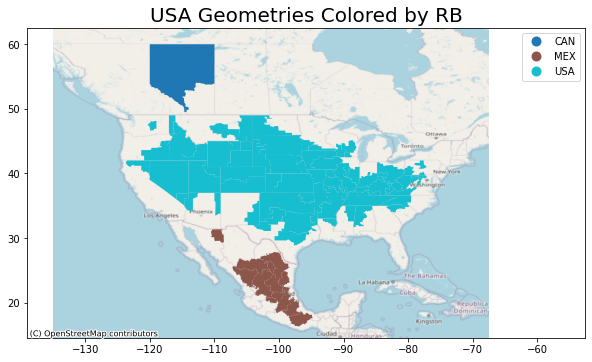

In [73]:
import geopandas as gpd
import matplotlib.pyplot as plt
import contextily as ctx

# Path to the updated shapefile
output_shapefile_path = '/Users/ansonkong/Downloads/merradownload-master/shapefile/updated_base_geometries.shp'

# Read the shapefile into a GeoDataFrame
base_gdf = gpd.read_file(output_shapefile_path)

# Check if 'country' and 'rb' columns exist
if 'country' in base_gdf.columns and 'rb' in base_gdf.columns:
    # Filter the GeoDataFrame for rows where country equals 'USA'
    usa_gdf = base_gdf
    
    # Initialize a plot
    fig, ax = plt.subplots(figsize=(10, 10))
    
    # Plot the filtered GeoDataFrame, coloring by 'rb' if you want to visualize this attribute
    usa_gdf.plot(ax=ax, column='country', legend=True)
    
    # Optionally, add a basemap for better context
    ctx.add_basemap(ax, source=ctx.providers.OpenStreetMap.Mapnik, crs=usa_gdf.crs.to_string())
    
    # Adjust the plot's limits to fit the geometries
    ax.set_xlim(usa_gdf.total_bounds[[0, 2]])
    ax.set_ylim(usa_gdf.total_bounds[[1, 3]])
    
    # Add titles and labels as needed
    ax.set_title('USA Geometries Colored by RB', fontsize=20)
    
    plt.show()
else:
    print("The required columns ('country' or 'rb') are not present in the GeoDataFrame.")
